# Materials associated with manuscript "Tropical weathering of the Taconic orogeny as a driver for Ordovician cooling"

This Jupyter notebook documents the data, data analysis and figure generation used for the manuscript:

Swanson-Hysell and Macdonald, (2017). Tropical weathering of the Taconic orogeny as a driver for Ordovician cooling, Geology, doi:10.1130/G38985.1

The code in this notebook is written in Python 2.7. It utilizes standard scientific Python modules as well as modules from the open source PmagPy project (https://github.com/PmagPy/) and pygplates which provides a Python API to the open source GPlates software (https://www.gplates.org/). An executable version of this notebook as well as all of the data files is available in this Github repository: https://github.com/Swanson-Hysell/Ordovician_Arc_Paleogeo.

# Import Python modules

In [41]:
import pandas as pd
import numpy as np
import pmagpy.ipmag as ipmag
import pmagpy.pmag as pmag
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
%config InlineBackend.figure_format = 'svg'
%matplotlib inline

# Paleomagnetic data

## Data from Taconic terranes

Import the Pmag_Data_Terranes.xlsx file which contains compiled paleomagnetic data from relevant Taconic terranes which we group as: Popelogan-Victoria, Bronson Hill, Gander, Annieopsquotch, Notre Dame, and Avalonia.

In [2]:
terrane_pmag = pd.read_excel("../Data/Pmag/Pmag_Data_Terranes.xlsx")

## Calculate paleolatitudes from allochthonous terrane data

Use the ```ipmag.lat_from_inc``` function to calculate the paleolatitudes implied by the study mean inclinations and then display the data.

In [3]:
for n in list(terrane_pmag.index.values):
    if terrane_pmag.Inc[n] != 'NaN':
        Paleolat, Paleolat_min, Paleolat_max = ipmag.lat_from_inc(terrane_pmag.Inc[n],a95=terrane_pmag.a95[n])
        terrane_pmag.set_value(n,'Paleolat',round(Paleolat,1))
        terrane_pmag.set_value(n,'Paleolat_max',round(Paleolat_max,1))
        terrane_pmag.set_value(n,'Paleolat_min',round(Paleolat_min,1))
terrane_pmag.to_excel('../Data/Pmag/Terrane_Pmag_Data.xls')
terrane_pmag

,Formation,Terrane,Slat,Slon,Dec,Inc,n,k,a95,Paleolat,Paleolat_max,Paleolat_min,Age,Age_Error,Age_Note,Age_ref,Pmag_ref,Notes
0,Springdale and Wigwam redbeds,Popelogan-Victoria,49.0,-55.5,37.2,-36.7,7.0,25.0,12.4,-20.4,-30.0,-12.7,433.0,6.0,upper Llandovery to Wenlock,"Arnott et al., 1985","Stamatakos et al., 1995",red beds
1,Lawrenceton Formation Volcanics,Popelogan-Victoria,49.2,-55.2,15.5,-27.2,10.0,18.0,8.1,-14.4,-19.5,-9.8,433.0,6.0,upper Llandovery to Wenlock,"Arnott et al., 1985","Smethurst and McEnroe, 2003",subaerial rhyolitic lava flows; pass tilt test
2,Winterville Volcanics,Bronson Hill,46.8,-68.7,327.0,-21.0,10.0,28.0,9.3,-10.9,-16.3,-5.9,456.5,3.5,"upper Darawillian to Sandbian, overlain by Kat...","van Staal et al., 2016 and references therein","Potts et al., 1995",extrusive pillow lavas; pass tilt test
3,Bluffer Pond Volcanics,Bronson Hill,46.5,-69.0,339.0,-28.0,14.0,12.0,11.9,-14.9,-22.7,-8.2,456.5,3.5,"upper Darawillian to Sandbian, overlain by Kat...","van Staal et al., 2016 and references therein","Potts et al., 1993",extrusive pillow lavas (11 sites); gabbro (3 s...
4,Tetagouche Group Volcanics,Gander,47.0,-66.0,240.0,-69.0,7.0,22.0,13.0,-52.5,-74.3,-36.5,463.5,6.5,"U-Pb multigrain TIMS dates of 457 +/- 3 Ma, 4...","Sullivan & van Staal, 1996; van Staal et al., ...","Liss et al., 1993",extrusive pillow lavas; pass tilt test; dual p...
5,Stacyville Volcanics,Bronson Hill,46.0,-68.6,270.0,-36.0,4.0,12.0,11.8,-20.0,-28.9,-12.7,467.0,5.0,U-Pb zircon date on dacite at top of sequence;...,"Ayuso et al., 2003","Wellensiek et al., 1990",extrusive pillow lavas
6,Lawrence Head Volcanics,Popelogan-Victoria,49.4,-55.1,236.0,-23.0,6.0,14.0,18.5,-12.0,-23.9,-2.3,465.0,2.0,Darawillian,"Schoonmaker et al., 2014","Todaro et al., 1996",extrusive pillow lavas; magnetite remanence; p...
7,Roberts Arm Volcanics,Annieopsquotch,49.5,-55.8,341.0,-52.0,16.0,14.0,11.0,-32.6,-44.5,-23.5,468.5,4.5,473-464 Ma SHRIMP U-Pb zircon,"Zagorevski et al., 2015","Van der Voo et al., 1991",extrusive pillow lavas; pass tilt test; dual p...
8,Summerford Volcanics,Popelogan-Victoria,49.5,-54.8,342.0,-50.0,9.0,31.0,9.0,-30.8,-39.8,-23.5,469.0,4.0,U-Pb TIMS on Coaker porphry; syn depositional ...,"Zagorezski et al., 2012","Van der Voo et al., 1991",extrusive pillow lavas
9,Chanceport/Cortell's Cove Volcanics,Annieopsquotch,49.5,-54.8,352.0,-49.0,10.0,50.0,7.0,-29.9,-36.5,-24.2,468.5,4.5,473-464 Ma by correlation with Roberts Arm; a ...,"Zagorevski et al., 2015","Van der Voo et al., 1991",extrusive pillow lavas


## Split the data by terrane assignment

In [4]:
Victoria_pmag = terrane_pmag.ix[terrane_pmag.Terrane=='Popelogan-Victoria']
Bronson_Hill_pmag = terrane_pmag.ix[terrane_pmag.Terrane=='Bronson Hill']
Annieopsquotch_pmag = terrane_pmag.ix[terrane_pmag.Terrane=='Annieopsquotch']
Notre_Dame_pmag = terrane_pmag.ix[terrane_pmag.Terrane=='Notre Dame']
Gander_pmag = terrane_pmag.ix[terrane_pmag.Terrane=='Gander']
Avalonia_pmag = terrane_pmag.ix[terrane_pmag.Terrane=='West Avalonia']

## Data from cratonic Laurentia

Import the Laurentia_Poles.xlsx file which contains paleomagnetic poles for Laurentia as compiled in Torsvik et al. (2012).

In [5]:
Laurentia_Poles = pd.read_excel("../Data/Pmag/Laurentia_Poles.xlsx")
Laurentia_Poles

,Terrane,Q,Formation,Slat,Slon,Dec,Inc,n,k,a95,...,Paleolat,Paleolat_max,Paleolat_min,Age,Age_Error,Age_Note,Age_ref,Pmag_ref,Notes from Torsvik,Notes
0,Laurentia,6,Dewey Lake Formation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,250.0,NaN,NaN,NaN,"2303, T",NaN,NaN
1,Laurentia,4,Bernal Formation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,255.0,NaN,NaN,NaN,"2489, T",corrected for counterclockwise Colorado Platea...,NaN
2,Laurentia,4,Ochoan red beds,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,258.0,NaN,NaN,NaN,"688, T",NaN,NaN
3,Laurentia,5,Guadalupian red beds,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,263.0,NaN,NaN,NaN,"688, T",NaN,NaN
4,Laurentia,5,Intrusions Southern Illinois,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,270.0,NaN,NaN,NaN,"Domeier et al., 2011a",NaN,NaN
5,Laurentia,4,Downey Bluff sill,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,272.0,NaN,NaN,NaN,Reynolds et al. (1997),NaN,NaN
6,Laurentia,4,Hicks Dome breccia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,272.0,NaN,NaN,NaN,Reynolds et al. (1997),NaN,NaN
7,Laurentia,3,Toroweap Formation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,277.0,NaN,NaN,NaN,"688, T",corrected for counterclockwise Colorado Platea...,NaN
8,Laurentia,3,Leonardian subset,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,277.0,NaN,NaN,NaN,"688, T",NaN,NaN
9,Laurentia,7,Artinskian Pictou red beds,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,280.0,NaN,NaN,NaN,"2281, T",NaN,NaN


## Calculate paleolatitudes implied by Laurentia poles

For comparision to the data from the Taconic terranes, the paleolatitudes implied by the Laurentia poles are calculated for present-day New York City and Baie Vert, Newfoundland.

In [6]:
reference_lat_NY = 40.7
reference_lon_NY = -74

for n in range(len(Laurentia_Poles)):
    PLon_N = (Laurentia_Poles.Plon[n]-180.)%360
    PLat_N = -Laurentia_Poles.Plat[n]
    Paleolat = 90 - pmag.angle([reference_lon_NY,reference_lat_NY],[PLon_N,PLat_N])
    Laurentia_Poles.loc[n,'Paleolat_NY'] = Paleolat
    
reference_lat_newfie = 49.9
reference_lon_newfie = -56.2
    
for n in range(len(Laurentia_Poles)):
    PLon_N = (Laurentia_Poles.Plon[n]-180.)%360
    PLat_N = -Laurentia_Poles.Plat[n]
    Paleolat = 90 - pmag.angle([reference_lon_newfie,reference_lat_newfie],[PLon_N,PLat_N])
    Laurentia_Poles.loc[n,'Paleolat_newfie'] = Paleolat

## Reconsidering Tablehead and St. George poles

The Hodych (1989) study that published data from the Tablehead Group showed that the limestones were remagnetized after deposition, but before folding (positive fold test and negative conglomerate test). Therefore, it and the underlying St. George Group limestone poles aren't robust constraints on Laurentia's position at the time of their deposition in the Ordovician as they were likely remagnetized during burial. The code below removes them from the Laurentia poles dataframe.

In [7]:
index_Tablehead = Laurentia_Poles.ix[Laurentia_Poles.Formation=='Tablehead Group']
index_St_George = Laurentia_Poles.ix[Laurentia_Poles.Formation=='St. George Group']

Laurentia_Poles_filtered = Laurentia_Poles.drop([index_Tablehead.index.values[0],
                                                 index_St_George.index.values[0]])

## Plot Laurentia poles

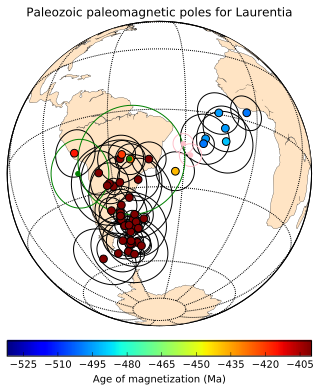

In [8]:
plt.figure(figsize=(6, 6))
pmap = Basemap(projection='ortho',lat_0=-25,lon_0=320,
               resolution='c',area_thresh=50000)
pmap.drawcoastlines(linewidth=0.25)
pmap.fillcontinents(color='bisque',lake_color='white',zorder=1)
pmap.drawmapboundary(fill_color='white')
pmap.drawmeridians(np.arange(0,360,30))
pmap.drawparallels(np.arange(-90,90,30))

for n in list(Laurentia_Poles_filtered.index.values):
     m = ipmag.plot_pole_colorbar(pmap, Laurentia_Poles_filtered['Plon'][n],
                                  Laurentia_Poles_filtered['Plat'][n],
                                  Laurentia_Poles_filtered['A95'][n],
                                  -Laurentia_Poles_filtered['Age'][n],
                                  -532,
                                  -400,
                                  markersize=60)

pmap.colorbar(m,location='bottom',pad="5%",label='Age of magnetization (Ma)')

#plot the St_George and Tablehead poles in pink
ipmag.plot_pole(pmap,Laurentia_Poles['Plon'][index_St_George.index.values[0]],
                Laurentia_Poles['Plat'][index_St_George.index.values[0]],
                Laurentia_Poles['A95'][index_St_George.index.values[0]],color='pink')
ipmag.plot_pole(pmap,Laurentia_Poles['Plon'][index_Tablehead.index.values[0]],
                Laurentia_Poles['Plat'][index_Tablehead.index.values[0]],
                Laurentia_Poles['A95'][index_Tablehead.index.values[0]],color='pink')

#plot the Juniata Poles in green
ipmag.plot_pole(pmap,105-180,-21,13,color='green')
ipmag.plot_pole(pmap,128-180,-19,21,color='green')

plt.title('Paleozoic paleomagnetic poles for Laurentia')
plt.show()

## Plot paleolatitude implied by Laurentia poles and Taconic data

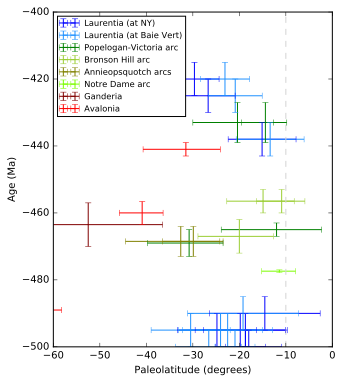

In [9]:
ax1 = plt.figure(figsize=(5,6))

def plot_paleolat():
    #plot paleolat implied by Laurentia poles
    for n in list(Laurentia_Poles_filtered.index.values)[35:-1]:
        plt.errorbar(Laurentia_Poles_filtered.Paleolat_NY[n], -Laurentia_Poles_filtered.Age[n], xerr=[[Laurentia_Poles_filtered.A95[n]],[Laurentia_Poles_filtered.A95[n]]],
             yerr=[[Laurentia_Poles_filtered.Age_Error[n]],[Laurentia_Poles_filtered.Age_Error[n]]],color='blue')    
    for n in list(Laurentia_Poles_filtered.index.values)[-1:]:
        plt.errorbar(Laurentia_Poles_filtered.Paleolat_NY[n], -Laurentia_Poles_filtered.Age[n], xerr=[[Laurentia_Poles_filtered.A95[n]],[Laurentia_Poles_filtered.A95[n]]],
             yerr=[[Laurentia_Poles_filtered.Age_Error[n]],[Laurentia_Poles_filtered.Age_Error[n]]],color='blue',label='Laurentia (at NY)')
    for n in list(Laurentia_Poles_filtered.index.values)[35:-1]:
        plt.errorbar(Laurentia_Poles_filtered.Paleolat_newfie[n], -Laurentia_Poles_filtered.Age[n], xerr=[[Laurentia_Poles_filtered.A95[n]],[Laurentia_Poles_filtered.A95[n]]],
             yerr=[[Laurentia_Poles_filtered.Age_Error[n]],[Laurentia_Poles_filtered.Age_Error[n]]],color='DodgerBlue')    
    for n in list(Laurentia_Poles_filtered.index.values)[-1:]:
        plt.errorbar(Laurentia_Poles_filtered.Paleolat_newfie[n], -Laurentia_Poles_filtered.Age[n], xerr=[[Laurentia_Poles_filtered.A95[n]],[Laurentia_Poles_filtered.A95[n]]],
             yerr=[[Laurentia_Poles_filtered.Age_Error[n]],[Laurentia_Poles_filtered.Age_Error[n]]],color='DodgerBlue',label='Laurentia (at Baie Vert)')
    
    #plot Popelogan-Victoria paleolatitudes
    for n in list(Victoria_pmag.index.values)[:-1]:
        plt.errorbar(Victoria_pmag.Paleolat[n], -Victoria_pmag.Age[n],
                 xerr=[[Victoria_pmag.Paleolat[n]-Victoria_pmag.Paleolat_min[n]],[Victoria_pmag.Paleolat_max[n]-Victoria_pmag.Paleolat[n]]],
                 yerr=[[Victoria_pmag.Age_Error[n]],[Victoria_pmag.Age_Error[n]]],color='green')
    for n in list(Victoria_pmag.index.values)[-1:]:
        plt.errorbar(Victoria_pmag.Paleolat[n], -Victoria_pmag.Age[n],
                 xerr=[[Victoria_pmag.Paleolat[n]-Victoria_pmag.Paleolat_min[n]],[Victoria_pmag.Paleolat_max[n]-Victoria_pmag.Paleolat[n]]],
                 yerr=[[Victoria_pmag.Age_Error[n]],[Victoria_pmag.Age_Error[n]]],color='green',label='Popelogan-Victoria arc')
    
    #plot Bronson_Hill paleolatitudes      
    for n in list(Bronson_Hill_pmag.index.values)[:-1]:
        plt.errorbar(Bronson_Hill_pmag.Paleolat[n], -Bronson_Hill_pmag.Age[n],
                     xerr=[[Bronson_Hill_pmag.Paleolat[n]-Bronson_Hill_pmag.Paleolat_min[n]],[Bronson_Hill_pmag.Paleolat_max[n]-Bronson_Hill_pmag.Paleolat[n]]],
                     yerr=[[Bronson_Hill_pmag.Age_Error[n]],[Bronson_Hill_pmag.Age_Error[n]]],color='YellowGreen')
    for n in list(Bronson_Hill_pmag.index.values)[-1:]:
        plt.errorbar(Bronson_Hill_pmag.Paleolat[n], -Bronson_Hill_pmag.Age[n],
                     xerr=[[Bronson_Hill_pmag.Paleolat[n]-Bronson_Hill_pmag.Paleolat_min[n]],[Bronson_Hill_pmag.Paleolat_max[n]-Bronson_Hill_pmag.Paleolat[n]]],
                     yerr=[[Bronson_Hill_pmag.Age_Error[n]],[Bronson_Hill_pmag.Age_Error[n]]],color='YellowGreen',label='Bronson Hill arc')   
    
    #plot Annieopsquotch paleolatitudes      
    for n in list(Annieopsquotch_pmag.index.values)[:-1]:
        plt.errorbar(Annieopsquotch_pmag.Paleolat[n], -Annieopsquotch_pmag.Age[n],
                     xerr=[[Annieopsquotch_pmag.Paleolat[n]-Annieopsquotch_pmag.Paleolat_min[n]],[Annieopsquotch_pmag.Paleolat_max[n]-Annieopsquotch_pmag.Paleolat[n]]],
                     yerr=[[Annieopsquotch_pmag.Age_Error[n]],[Annieopsquotch_pmag.Age_Error[n]]],color='olive')
    for n in list(Annieopsquotch_pmag.index.values)[-1:]:
        plt.errorbar(Annieopsquotch_pmag.Paleolat[n], -Annieopsquotch_pmag.Age[n],
                     xerr=[[Annieopsquotch_pmag.Paleolat[n]-Annieopsquotch_pmag.Paleolat_min[n]],[Annieopsquotch_pmag.Paleolat_max[n]-Annieopsquotch_pmag.Paleolat[n]]],
                     yerr=[[Annieopsquotch_pmag.Age_Error[n]],[Annieopsquotch_pmag.Age_Error[n]]],color='olive',label='Annieopsquotch arcs')   
    
    #plot Notre Dame paleolatitudes    
    for n in list(Notre_Dame_pmag.index.values):
        plt.errorbar(Notre_Dame_pmag.Paleolat[n], -Notre_Dame_pmag.Age[n], 
                     xerr=[[Notre_Dame_pmag.Paleolat[n]-Notre_Dame_pmag.Paleolat_min[n]],[Notre_Dame_pmag.Paleolat_max[n]-Notre_Dame_pmag.Paleolat[n]]],
                     yerr=[[Notre_Dame_pmag.Age_Error[n]],[Notre_Dame_pmag.Age_Error[n]]],color='lawngreen',label='Notre Dame arc')
     
    #plot Gander paleolatitudes      
    for n in list(Gander_pmag.index.values):
        plt.errorbar(Gander_pmag.Paleolat[n], -Gander_pmag.Age[n],
                     xerr=[[Gander_pmag.Paleolat[n]-Gander_pmag.Paleolat_min[n]],[Gander_pmag.Paleolat_max[n]-Gander_pmag.Paleolat[n]]],
                     yerr=[[Gander_pmag.Age_Error[n]],[Gander_pmag.Age_Error[n]]],color='maroon',label='Ganderia')

    #plot Gander paleolatitudes      
    for n in list(Avalonia_pmag.index.values)[:-1]:
        plt.errorbar(Avalonia_pmag.Paleolat[n], -Avalonia_pmag.Age[n],
                    xerr=[[Avalonia_pmag.Paleolat[n]-Avalonia_pmag.Paleolat_min[n]],[Avalonia_pmag.Paleolat_max[n]-Avalonia_pmag.Paleolat[n]]],
                    yerr=[[Avalonia_pmag.Age_Error[n]],[Avalonia_pmag.Age_Error[n]]],color='red')
    for n in list(Avalonia_pmag.index.values)[-1:]:
        plt.errorbar(Avalonia_pmag.Paleolat[n], -Avalonia_pmag.Age[n],
                    xerr=[[Avalonia_pmag.Paleolat[n]-Avalonia_pmag.Paleolat_min[n]],[Avalonia_pmag.Paleolat_max[n]-Avalonia_pmag.Paleolat[n]]],
                    yerr=[[Avalonia_pmag.Age_Error[n]],[Avalonia_pmag.Age_Error[n]]],color='red',label='Avalonia')
 
plot_paleolat()
plt.xlabel('Paleolatitude (degrees)')
plt.ylabel('Age (Ma)')
plt.ylim(-500,-400)
plt.xlim(-60,0)
plt.vlines(-10,-500,-400,color='lightgrey',linestyle='--')
plt.legend(loc=2,fontsize='small')
plt.show()

# Chemostratigraphic data

This compilation utilizes the following data sets:
 
- The $^{87}$Sr/$^{86}$Sr composite from brachiopods and conodonts published in Prokoph (2008).
- The $^{87}$Sr/$^{86}$Sr composite from conodonts published in Saltzman et al. (2014).
- A compilation of Laurentia $\epsilon$Nd isotope data developed in conjunction with this study and split by data from distal margin sediments that from foreland basin sediments including data from: Andersen and Samson (1995); Gleason et al. (1995); Bock et al. (1996); Patchett et al. (1999); Gleason et al. (2002); Macdonald et al. (in press). 
- The $\delta^{18}$O isotope composite from tropical brachiopods published in Viezer (2015).
- A compilation of $\delta^{18}$O isotope data developed for conodonts including data from: Bassett et al. (2007); Trotter et al. (2008); Quinton and MacLeod, 2014; Trotter et al. (2016). 

In [10]:
O_composite_Viezer = pd.read_excel('../Data/O/Viezer_2015_Oxygen_tropical_brach.xlsx')
O_composite_conodont = pd.read_excel('../Data/O/Conodont_Phos_O_Composite.xlsx')

Sr_composite_Saltzman = pd.read_excel('../Data/Sr/Saltzman2014_Sr.xlsx')
Sr_composite_Prokoph = pd.read_excel('../Data/Sr/Prokoph_2008_Sr_500-400.xls')

Nd_composite = pd.read_excel('../Data/Nd/Laurentia_Ordo_Nd_Compilation.xlsx',index_col='Sample #')
Nd_composite_distal = Nd_composite.ix[Nd_composite.Setting == 'Distal margin']
Nd_composite_foreland = Nd_composite.ix[Nd_composite.Setting != 'Distal margin']

## Plot chemostratigraphic data along with paleolatitudinal constraints

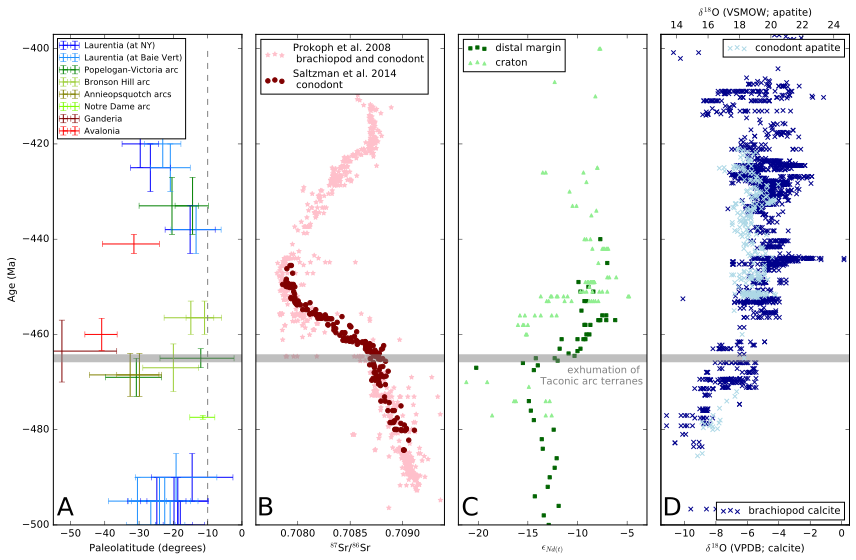

In [11]:
plt.figure(figsize=(12,8))

ax1 = plt.subplot(1,4,1)
plot_paleolat()
plt.xlabel('Paleolatitude (degrees)')
plt.ylabel('Age (Ma)')
plt.ylim(-500,-397)
plt.xlim(-55,0)
plt.vlines(-10,-500,-400,color='grey',linestyle='--')
plt.legend(loc=2,fontsize='small')
plt.text(-54, -498, 'A', fontsize=25)
ax1.axhline(-465,color='grey',linewidth=8,alpha=0.5)

ax2 = plt.subplot(1,4,2)
plt.scatter(Sr_composite_Prokoph['87Sr/86Sr'],-Sr_composite_Prokoph['Age (Ma)'],
            color='pink',marker='*',label='Prokoph et al. 2008\n brachiopod and conodont')
plt.scatter(Sr_composite_Saltzman['87_86'],-Sr_composite_Saltzman.Age,
            color='maroon',label='Saltzman et al. 2014\n conodont')
plt.xlim(.7076,.7094)
plt.ylim(-500,-397) 
plt.xlabel('$^{87}$Sr/$^{86}$Sr')
plt.legend(loc=2,fontsize='medium')
ax2.set_yticklabels([])
plt.text(.70761, -498, 'B', fontsize=25)
ax2.axhline(-465,color='grey',linewidth=8,alpha=0.5)

ax3 = plt.subplot(1,4,3)
plt.scatter(Nd_composite_distal['Epsilon Nd (t)'],-Nd_composite_distal['Age (Ma)'],
            color='darkgreen',marker='s',s=10,label='distal margin')
plt.scatter(Nd_composite_foreland['Epsilon Nd (t)'],-Nd_composite_foreland['Age (Ma)'],
            color='lightgreen',marker='^',s=10,label='craton')
plt.xlim(-22,-3)
plt.ylim(-500,-397)
plt.xlabel('$\epsilon_{Nd(t)}$')
plt.legend(loc=2,fontsize='medium')
ax3.set_yticklabels([])
plt.text(-21.7, -498, 'C', fontsize=25)
ax3.axhline(-465,color='grey',linewidth=8,alpha=0.5)
ax3.text(-3.4,-470.5,'exhumation of \n Taconic arc terranes',horizontalalignment='right',color='grey')

ax4 = plt.subplot(1,4,4)
plt.scatter(O_composite_Viezer.d18O,-O_composite_Viezer.gts2012,
            color='darkblue',marker='x',label='brachiopod calcite')
plt.xlim(-11.5,0.5)
plt.ylim(-500,-397)
plt.xlabel('$\delta^{18}$O (VPDB; calcite)')
plt.legend(loc='lower right',fontsize='medium')
ax5 = ax4.twiny()
ax5.scatter(O_composite_conodont['d18O_phos'],-O_composite_conodont['Age (Ma)'],
            color='lightblue',marker='x',label='conodont apatite')
plt.xlim(13,25)
plt.ylim(-500,-397)
plt.xlabel('$\delta^{18}$O (VSMOW; apatite)')
plt.legend(loc='upper right',fontsize='medium')
plt.text(13.1, -498, 'D', fontsize=25)
ax4.axhline(-465,color='grey',linewidth=8,alpha=0.5)
ax4.set_yticklabels([])

plt.tight_layout()
plt.savefig('./Output/composite_paleolat_chemostrat.pdf')
plt.show()

## Comparision between Sr and Nd curves

The downturn in global $^{87}$Sr/$^{86}$Sr values (shift to juvenile values) lags the uptick in Laurentian distal margin $\epsilon$Nd values (shift to juvenile values) as would be expected if the local weathering signal recorded on the Laurentian margin led to an appreciable change in global $^{87}$Sr/$^{86}$Sr input. The long residence time of Sr in the ocean (~2 Myr in the modern ocean) predicts a multi-million lag. The age model for the $^{87}$Sr/$^{86}$Sr data is based on the 2012 Geological Time Scale while the $\epsilon$Nd age model comes from U-Pb zircon ages within sections containing the data. As a result, the exact duration of the offset in the chemostratigraphic trends is difficult to constrain given that it depends on the accuracy of the calibration of the Geological Time Scale and therefore comes with uncertainity.

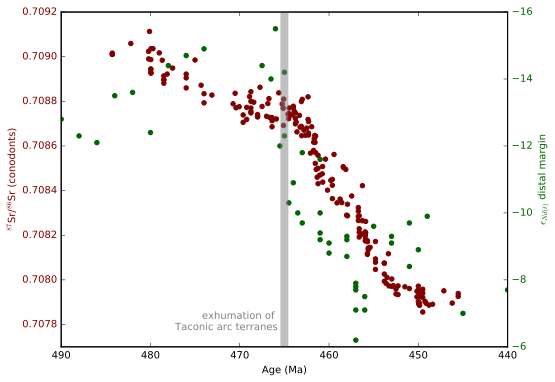

In [12]:
plt.figure(figsize=(8,6))
ax1 = plt.subplot()

ax1.scatter(Sr_composite_Saltzman.Age,Sr_composite_Saltzman['87_86'],color='maroon',label='Saltzman et al. (2014)')
ax1.set_xlim(440,490)
ax1.set_ylim(.7077,.7092)
ax1.set_ylabel('$^{87}$Sr/$^{86}$Sr (conodonts)', color='maroon')
for tl in ax1.get_yticklabels():
    tl.set_color('maroon')
ax1.set_xlabel('Age (Ma)')

ax2 = ax1.twinx()
ax2.scatter(Nd_composite_distal['Age (Ma)'],Nd_composite_distal['Epsilon Nd (t)'],color='darkgreen',label='distal margin')
ax2.set_xlim(440,490)
ax2.set_ylim(-16,-6)
ax2.invert_yaxis()
ax2.set_ylabel('$\epsilon_{Nd(t)}$ distal margin', color='darkgreen')
for tl in ax2.get_yticklabels():
    tl.set_color('darkgreen')
    
ax2.axvline(465,color='grey',linewidth=8,alpha=0.5)
ax2.text(465.75,-6.5,'exhumation of \n Taconic arc terranes',horizontalalignment='right',color='grey')

ax1.invert_xaxis()
plt.show()

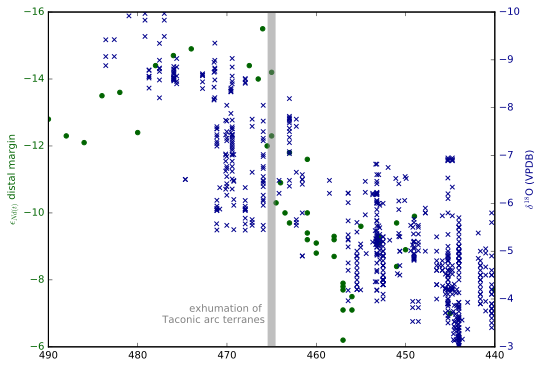

In [13]:
plt.figure(figsize=(8,6))
ax1 = plt.subplot()

ax1.scatter(Nd_composite_distal['Age (Ma)'],Nd_composite_distal['Epsilon Nd (t)'],color='darkgreen',label='distal margin')
ax1.set_xlim(440,490)
ax1.set_ylim(-16,-6)
ax1.invert_yaxis()
ax1.set_ylabel('$\epsilon_{Nd(t)}$ distal margin', color='darkgreen')
for tl in ax1.get_yticklabels():
    tl.set_color('darkgreen')

ax2 = ax1.twinx()
ax2.scatter(O_composite_Viezer.gts2012,O_composite_Viezer.d18O,color='darkblue',marker='x')
ax2.set_xlim(440,490)
ax2.set_ylim(-10,-3)
ax2.invert_yaxis()
ax2.set_ylabel('$\delta^{18}$O (VPDB)', color='darkblue')
for tl in ax2.get_yticklabels():
    tl.set_color('darkblue')
    
ax2.axvline(465,color='grey',linewidth=8,alpha=0.5)
ax2.text(465.75,-3.5,'exhumation of \n Taconic arc terranes',horizontalalignment='right',color='grey')

ax1.invert_xaxis()

plt.show()

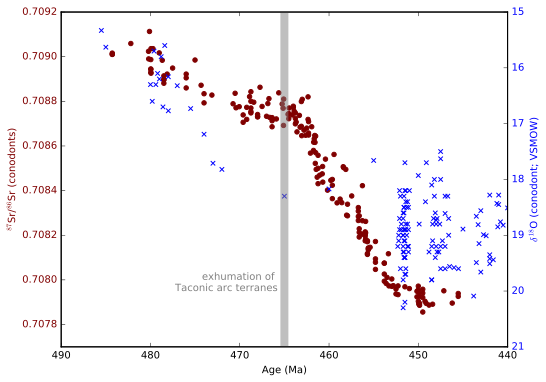

In [14]:
plt.figure(figsize=(8,6))
ax1 = plt.subplot()

ax1.scatter(Sr_composite_Saltzman.Age,Sr_composite_Saltzman['87_86'],color='maroon',label='Saltzman et al. (2014)')
ax1.set_xlim(440,490)
ax1.set_ylim(.7077,.7092)
ax1.set_ylabel('$^{87}$Sr/$^{86}$Sr (conodonts)', color='maroon')
for tl in ax1.get_yticklabels():
    tl.set_color('maroon')
ax1.set_xlabel('Age (Ma)')

ax2 = ax1.twinx()
ax2.scatter(O_composite_conodont['Age (Ma)'],O_composite_conodont['d18O_phos'],color='blue',marker='x')
ax2.set_xlim(440,490)
ax2.set_ylim(15,21)
ax2.invert_yaxis()
ax2.set_ylabel('$\delta^{18}$O (conodont; VSMOW)', color='blue')
for tl in ax2.get_yticklabels():
    tl.set_color('blue')
    
ax2.axvline(465,color='grey',linewidth=8,alpha=0.5)
ax2.text(465.75,20,'exhumation of \n Taconic arc terranes',horizontalalignment='right',color='grey')

ax1.invert_xaxis()
plt.show()

## Best fit curves to Sr data

Approaches to compiling the Sr isotope record have sought to develop regression curves that are taken as a a best-fit curve for marine $^{87}$Sr/$^{86}$Sr values through time (e.g. McArthur et al. 2012). We explore 3 approaches of fitting a best fit curve to the values:
- running mean
- spline (implemented via scipy UnivariateSpline)
- LOWESS (Locally Weighted Scatterplot Smoothing)

We consider the LOWESS approach to strike an effective balance between smoothing and honoring the values. The LOWESS approach is less sensitive to edge effects than the spline fit and achieves a smoother fit than the running mean as can be seen below.

In [15]:
x = Sr_composite_Saltzman.Age.tolist()
y = Sr_composite_Saltzman['87_86'].tolist()

from scipy.interpolate import interp1d
inter_Sr = interp1d(x, y,kind='linear')

Sr_rolling_mean = []
Sr_time_rolling = []
window = 6
for n in np.arange(445.0,480.0,0.5):
    old = Sr_composite_Saltzman.Age < n+(window/2)
    young = Sr_composite_Saltzman.Age > n-(window/2)
    window_df = Sr_composite_Saltzman[old & young]
    Sr_rolling_mean.append(window_df['87_86'].mean())
    Sr_time_rolling.append(n)

from scipy.interpolate import UnivariateSpline
spl_Sr = UnivariateSpline(x, y, k=5)

import statsmodels.api as sm
lowess = sm.nonparametric.lowess
lowess_Sr_3 = lowess(y, x,frac=0.3)

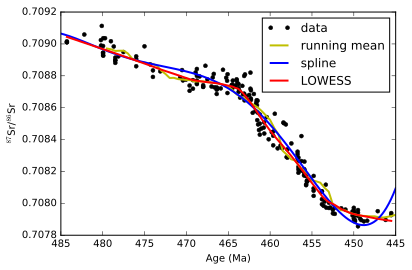

In [16]:
ax1 = plt.subplot()
#plot the data
plt.plot(x, y, 'ko', ms=4, label='data')

xs = np.linspace(445, 485, 1000)
#plot the running mean
plt.plot(Sr_time_rolling, Sr_rolling_mean, 'y', label='running mean',lw=2)

#plot the spline fit
plt.plot(xs, spl_Sr(xs), 'b', label='spline',lw=2)

#plot the LOWESS fit
plt.plot(lowess_Sr_3[:, 0],lowess_Sr_3[:, 1],'r',label='LOWESS',lw=2)

plt.ylabel('$^{87}$Sr/$^{86}$Sr')
plt.xlabel('Age (Ma)')
ax1.invert_xaxis()
plt.legend()
plt.show()

The ```sm.nonparametric.lowess``` function requires a parameter frac which specifies what fracion of the data are being utilized for the locally weighted scatterplot smoothing. The code below develops the LOWESS fit using a variety of frac values and plots them. Inspecting these fits reveals that the data are underfit by fracs 0.4 and above. A frac of 0.3 appears to strike a good balance between under-fitting and over-fitting the data.

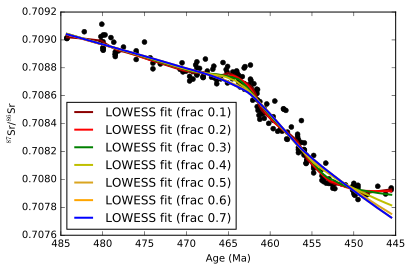

In [17]:
x = Sr_composite_Saltzman.Age.tolist()
y = Sr_composite_Saltzman['87_86'].tolist()

lowess_Sr_1 = lowess(y, x,frac=0.1)
lowess_Sr_2 = lowess(y, x,frac=0.2)
lowess_Sr_3 = lowess(y, x,frac=0.3)
lowess_Sr_4 = lowess(y, x,frac=0.4)
lowess_Sr_5 = lowess(y, x,frac=0.5)
lowess_Sr_6 = lowess(y, x,frac=0.6)
lowess_Sr_7 = lowess(y, x,frac=0.7)

ax1 = plt.subplot()
plt.plot(x, y, 'ko', ms=5)
plt.plot(lowess_Sr_1[:, 0],lowess_Sr_1[:, 1],'darkred',lw=2,label='LOWESS fit (frac 0.1)')
plt.plot(lowess_Sr_2[:, 0],lowess_Sr_2[:, 1],'r',lw=2,label='LOWESS fit (frac 0.2)')
plt.plot(lowess_Sr_3[:, 0],lowess_Sr_3[:, 1],'g',lw=2,label='LOWESS fit (frac 0.3)')
plt.plot(lowess_Sr_4[:, 0],lowess_Sr_4[:, 1],'y',lw=2,label='LOWESS fit (frac 0.4)')
plt.plot(lowess_Sr_5[:, 0],lowess_Sr_5[:, 1],'goldenrod',lw=2,label='LOWESS fit (frac 0.5)')
plt.plot(lowess_Sr_6[:, 0],lowess_Sr_6[:, 1],'orange',lw=2,label='LOWESS fit (frac 0.6)')
plt.plot(lowess_Sr_6[:, 0],lowess_Sr_6[:, 1],'b',lw=2,label='LOWESS fit (frac 0.7)')

plt.ylabel('$^{87}$Sr/$^{86}$Sr')
plt.xlabel('Age (Ma)')
plt.legend(loc=3)
ax1.invert_xaxis()
plt.show()

## Best fit curves to Nd data

It is less appropriate to fit a best fit curve to the Nd data then to the Sr data. In the case of the Sr data, each value should be drawn from a smoothly evolving marine Sr reservoir. For the Nd data, there is more inherent variability as the signal is a local one connected to the sediment provenance. However, there is a significant inflection in the data to higher (more juvenile) values that occurs at the time of exhumation of arc terranes. Therefore, we interpret a running mean fit to these data to be associated with evolving tectonic boundary conditions. Given that changes in local sediment provenance are a lever on the global Sr isotope signal, a best fit curve can be used to establish the timing of the observed shift in the data. 

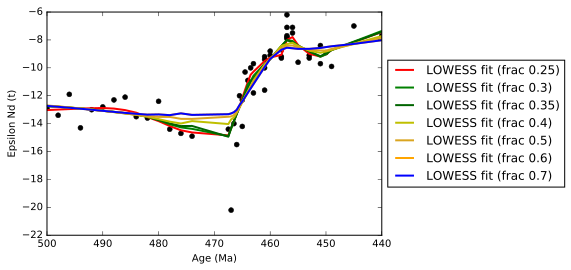

In [18]:
x = Nd_composite_distal['Age (Ma)'].tolist()
y = Nd_composite_distal['Epsilon Nd (t)'].tolist()

lowess_Nd_25 = lowess(y, x,frac=0.25)
lowess_Nd_3 = lowess(y, x,frac=0.3)
lowess_Nd_35 = lowess(y, x,frac=0.35)
lowess_Nd_4 = lowess(y, x,frac=0.4)
lowess_Nd_5 = lowess(y, x,frac=0.5)
lowess_Nd_6 = lowess(y, x,frac=0.6)
lowess_Nd_7 = lowess(y, x,frac=0.7)

ax1 = plt.subplot()
plt.plot(x, y, 'ko', ms=5)

plt.plot(lowess_Nd_25[:, 0],lowess_Nd_25[:, 1],'r',lw=2,label='LOWESS fit (frac 0.25)')
plt.plot(lowess_Nd_3[:, 0],lowess_Nd_3[:, 1],'g',lw=2,label='LOWESS fit (frac 0.3)')
plt.plot(lowess_Nd_35[:, 0],lowess_Nd_35[:, 1],'darkgreen',lw=2,label='LOWESS fit (frac 0.35)')
plt.plot(lowess_Nd_4[:, 0],lowess_Nd_4[:, 1],'y',lw=2,label='LOWESS fit (frac 0.4)')
plt.plot(lowess_Nd_5[:, 0],lowess_Nd_5[:, 1],'goldenrod',lw=2,label='LOWESS fit (frac 0.5)')
plt.plot(lowess_Nd_6[:, 0],lowess_Nd_6[:, 1],'orange',lw=2,label='LOWESS fit (frac 0.6)')
plt.plot(lowess_Nd_6[:, 0],lowess_Nd_6[:, 1],'b',lw=2,label='LOWESS fit (frac 0.7)')

plt.ylabel('Epsilon Nd (t)')
plt.xlabel('Age (Ma)')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax1.invert_xaxis()
plt.show()

The point at ca. 467.5 Ma with a εNd(t) value of less than -20 appears to be an outlier. This value is robust and likely relates to a local signal of exhumation of a terrane with low εNd values. The code below explores how much the LOWESS fits change when this point is removed and reveals that the LOWESS fit isn't particularly sensitive to such an outlier. This lack of outlier sensitivity is acheived through implementing the iterative robust version of LOWESS:

*Cleveland, W.S. (1979) "Robust Locally Weighted Regression and Smoothing Scatterplots". Journal of the American Statistical Association 74 (368): 829-836.*

This lack of outlier sensitivity contrasts with the spline and running mean curves. As with the Sr data, the LOWESS with a frac of 0.3 regression strikes a good balance as a best to the data in comparision with the spline and running mean approaches.

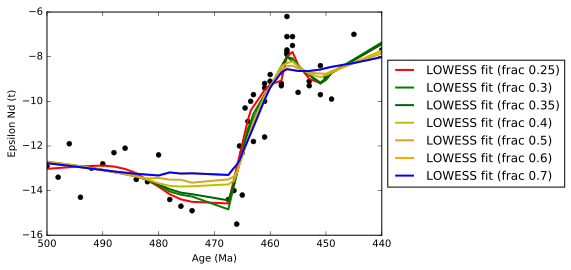

In [19]:
Nd_composite_distal_filtered = Nd_composite_distal.ix[Nd_composite_distal['Epsilon Nd (t)']>-20]
x = Nd_composite_distal_filtered['Age (Ma)'].tolist()
y = Nd_composite_distal_filtered['Epsilon Nd (t)'].tolist()

lowess_Nd_25 = lowess(y, x,frac=0.25)
lowess_Nd_3 = lowess(y, x,frac=0.3)
lowess_Nd_35 = lowess(y, x,frac=0.35)
lowess_Nd_4 = lowess(y, x,frac=0.4)
lowess_Nd_5 = lowess(y, x,frac=0.5)
lowess_Nd_6 = lowess(y, x,frac=0.6)
lowess_Nd_7 = lowess(y, x,frac=0.7)

ax1 = plt.subplot()
plt.plot(x, y, 'ko', ms=5)

plt.plot(lowess_Nd_25[:, 0],lowess_Nd_25[:, 1],'r',lw=2,label='LOWESS fit (frac 0.25)')
plt.plot(lowess_Nd_3[:, 0],lowess_Nd_3[:, 1],'g',lw=2,label='LOWESS fit (frac 0.3)')
plt.plot(lowess_Nd_35[:, 0],lowess_Nd_35[:, 1],'darkgreen',lw=2,label='LOWESS fit (frac 0.35)')
plt.plot(lowess_Nd_4[:, 0],lowess_Nd_4[:, 1],'y',lw=2,label='LOWESS fit (frac 0.4)')
plt.plot(lowess_Nd_5[:, 0],lowess_Nd_5[:, 1],'goldenrod',lw=2,label='LOWESS fit (frac 0.5)')
plt.plot(lowess_Nd_6[:, 0],lowess_Nd_6[:, 1],'orange',lw=2,label='LOWESS fit (frac 0.6)')
plt.plot(lowess_Nd_6[:, 0],lowess_Nd_6[:, 1],'b',lw=2,label='LOWESS fit (frac 0.7)')

plt.ylabel('Epsilon Nd (t)')
plt.xlabel('Age (Ma)')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax1.invert_xaxis()
plt.show()

## Best fit curves to O data

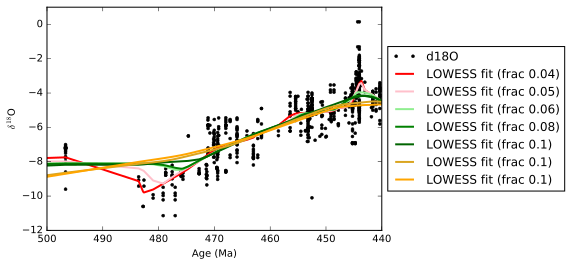

In [20]:
x = O_composite_Viezer.gts2012
y = O_composite_Viezer.d18O

lowess_O_04 = lowess(y, x,frac=0.04)
lowess_O_05 = lowess(y, x,frac=0.05)
lowess_O_06 = lowess(y, x,frac=0.06)
lowess_O_08 = lowess(y, x,frac=0.08)
lowess_O_1 = lowess(y, x,frac=0.1)
lowess_O_2 = lowess(y, x,frac=0.2)
lowess_O_3 = lowess(y, x,frac=0.3)

ax1 = plt.subplot()
plt.plot(x, y, 'ko', ms=3)

plt.plot(lowess_O_04[:, 0],lowess_O_04[:, 1],'r',lw=2,label='LOWESS fit (frac 0.04)')
plt.plot(lowess_O_05[:, 0],lowess_O_05[:, 1],'pink',lw=2,label='LOWESS fit (frac 0.05)')
plt.plot(lowess_O_06[:, 0],lowess_O_06[:, 1],'lightgreen',lw=2,label='LOWESS fit (frac 0.06)')
plt.plot(lowess_O_08[:, 0],lowess_O_08[:, 1],'g',lw=2,label='LOWESS fit (frac 0.08)')
plt.plot(lowess_O_1[:, 0],lowess_O_1[:, 1],'darkgreen',lw=2,label='LOWESS fit (frac 0.1)')
plt.plot(lowess_O_2[:, 0],lowess_O_2[:, 1],'goldenrod',lw=2,label='LOWESS fit (frac 0.1)')
plt.plot(lowess_O_3[:, 0],lowess_O_3[:, 1],'orange',lw=2,label='LOWESS fit (frac 0.1)')

plt.ylabel('$\delta^{18}$O')
plt.xlabel('Age (Ma)')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlim(440,500)
plt.ylim(-12,1)
ax1.invert_xaxis()
plt.show()

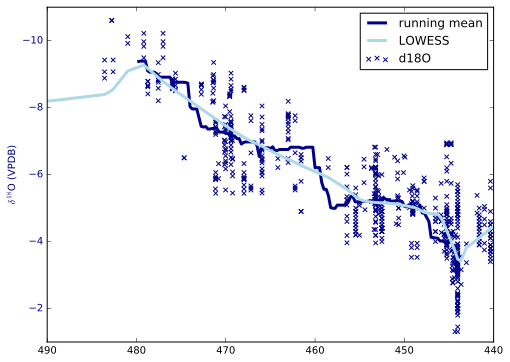

In [21]:
O_rolling_mean = []
O_time_rolling = []
window = 6
for n in np.arange(445.0,480.0,0.25):
    old = O_composite_Viezer.gts2012 < n+(window/2)
    young = O_composite_Viezer.gts2012 > n-(window/2)
    window_df = O_composite_Viezer[old & young]
    O_rolling_mean.append(window_df.d18O.mean())
    O_time_rolling.append(n)

plt.figure(figsize=(8,6))
ax2 = plt.subplot()
ax2.scatter(O_composite_Viezer.gts2012,O_composite_Viezer.d18O,color='darkblue',marker='x')
for tl in ax2.get_yticklabels():
    tl.set_color('darkblue')
ax2.plot(O_time_rolling,O_rolling_mean,color='darkblue',lw=3,label='running mean')
ax2.plot(lowess_O_05[:,0],lowess_O_05[:,1],color='lightblue',lw=3,label='LOWESS')
ax2.set_ylabel('$\delta^{18}$O (VPDB)', color='darkblue')
ax2.set_xlim(440,490)
ax2.set_ylim(-11,-1)
ax2.invert_yaxis()
ax2.invert_xaxis()
plt.legend()
plt.show()

## Composite LOWESS curves

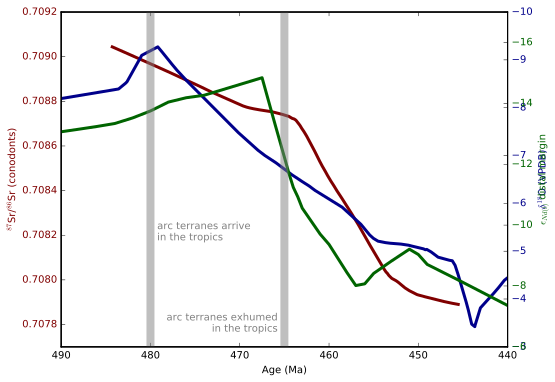

In [22]:
plt.figure(figsize=(8,6))
ax1 = plt.subplot()
Sr_spline = plt.plot(lowess_Sr_3[:, 0],lowess_Sr_3[:, 1],'maroon',label='Sr LOWESS',lw=3)
ax1.set_xlim(440,490)
ax1.set_ylim(.7077,.7092)
# Make the y-axis label and tick labels match the line color.
ax1.set_ylabel('$^{87}$Sr/$^{86}$Sr (conodonts)', color='maroon')
for tl in ax1.get_yticklabels():
    tl.set_color('maroon')
ax1.set_xlabel('Age (Ma)')

ax2 = ax1.twinx()
ax2.set_xlim(440,490)
ax2.set_ylim(-10,-3)
ax2.invert_yaxis()
ax2.set_ylabel('$\delta^{18}$O (VPDB)', color='darkblue')
for tl in ax2.get_yticklabels():
    tl.set_color('darkblue')
ax2.plot(lowess_O_05[:,0],lowess_O_05[:,1],color='darkblue',lw=3,label='O LOWESS')
    
ax3 = ax1.twinx()
Nd_LOWESS = plt.plot(lowess_Nd_3[:, 0],lowess_Nd_3[:, 1],'darkgreen',label='Nd LOWESS',lw=3)
ax3.set_xlim(440,490)
ax3.set_ylim(-17,-6)
ax3.invert_yaxis()
ax3.set_ylabel('$\epsilon_{Nd(t)}$ distal margin', color='darkgreen')
for tl in ax3.get_yticklabels():
    tl.set_color('darkgreen')
    
ax3.axvline(480,color='grey',linewidth=8,alpha=0.5)
ax3.text(479.25,-9.5,'arc terranes arrive\nin the tropics',horizontalalignment='left',color='grey')
    
ax3.axvline(465,color='grey',linewidth=8,alpha=0.5)
ax3.text(465.75,-6.5,'arc terranes exhumed\nin the tropics',horizontalalignment='right',color='grey')

ax1.invert_xaxis()
plt.show()

## Temporal gap between Nd and Sr trends

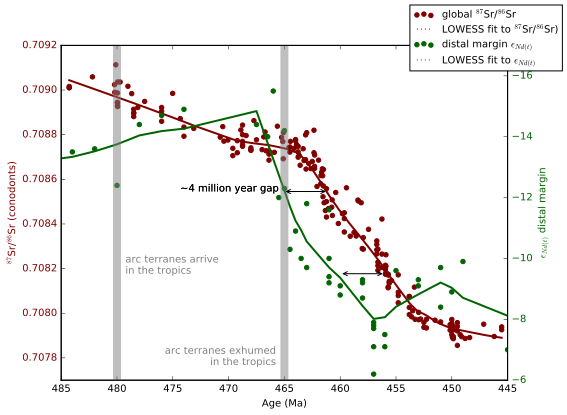

In [23]:
fig = plt.figure(figsize=(8,6))
ax1 = plt.subplot()

Sr_scatter = ax1.scatter(Sr_composite_Saltzman.Age,Sr_composite_Saltzman['87_86'],color='maroon',label='global $^{87}$Sr/$^{86}$Sr')
Sr_lowess = plt.plot(lowess_Sr_3[:, 0],lowess_Sr_3[:, 1], 'maroon', lw=2,label = 'LOWESS fit to $^{87}$Sr/$^{86}$Sr')
ax1.set_xlim(445,485)
ax1.set_ylim(.7077,.7092)
ax1.set_ylabel('$^{87}$Sr/$^{86}$Sr (conodonts)', color='maroon')
for tl in ax1.get_yticklabels():
    tl.set_color('maroon')
ax1.set_xlabel('Age (Ma)')


ax2 = ax1.twinx()
Nd_scatter = ax2.scatter(Nd_composite_distal['Age (Ma)'],Nd_composite_distal['Epsilon Nd (t)'],
            color='darkgreen',label='distal margin $\epsilon_{Nd(t)}$')
Nd_lowess = plt.plot(lowess_Nd_3[:, 0],lowess_Nd_3[:, 1], 'darkgreen', lw=2, label='LOWESS fit to $\epsilon_{Nd(t)}$')
ax2.set_xlim(445,485)
ax2.set_ylim(-17,-6)
ax2.invert_yaxis()
ax2.set_ylabel('$\epsilon_{Nd(t)}$ distal margin', color='darkgreen')
for tl in ax2.get_yticklabels():
    tl.set_color('darkgreen')
    

ax2.axvline(480,color='grey',linewidth=8,alpha=0.5)
ax2.text(479.25,-9.5,'arc terranes arrive\nin the tropics',horizontalalignment='left',color='grey')
    
ax2.axvline(465,color='grey',linewidth=8,alpha=0.5)
ax2.text(465.75,-6.5,'arc terranes exhumed\nin the tropics',horizontalalignment='right',color='grey')

ax2.annotate('', (461.1, -12.2), (465.1, -12.2), arrowprops={'arrowstyle':'<->'})
ax2.annotate('~4 million year gap', xy=(465.5, -12.2), xycoords='data',horizontalalignment='right')

ax2.annotate('', (456, -9.5), (460, -9.5), arrowprops={'arrowstyle':'<->'})
ax2.annotate('~4 million year gap', xy=(465.5, -12.2), xycoords='data',horizontalalignment='right')

ax1.invert_xaxis()

import matplotlib.lines as mlines
maroon_line = mlines.Line2D([], [], color='maroon',linestyle=':')
green_line = mlines.Line2D([], [], color='darkgreen',linestyle=':')
fig.legend((Sr_scatter, maroon_line, Nd_scatter, green_line),
           ('global $^{87}$Sr/$^{86}$Sr', 'LOWESS fit to $^{87}$Sr/$^{86}$Sr)',
            'distal margin $\epsilon_{Nd(t)}$','LOWESS fit to $\epsilon_{Nd(t)}$'),fontsize=10)

plt.show()

In [24]:
from scipy import interpolate

inter_Nd = interpolate.interp1d(lowess_Nd_3[:, 0],lowess_Nd_3[:, 1])
inter_Sr = interpolate.interp1d(lowess_Sr_3[:, 0],lowess_Sr_3[:, 1])

inter_time = []
inter_Nd_delta = []
inter_Sr_delta = []
for n in np.arange(448, 480, 0.1):
    inter_time.append(n)
    Nd_delta = inter_Nd(n)-inter_Nd(n-0.1)
    Sr_delta = inter_Sr(n)-inter_Sr(n-0.1)
    inter_Nd_delta.append(Nd_delta)
    inter_Sr_delta.append(Sr_delta)

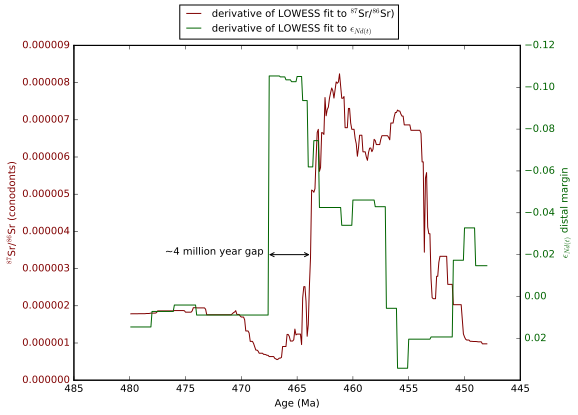

In [25]:
fig = plt.figure(figsize=(8,6))
ax1 = plt.subplot()

Sr_delta = ax1.plot(inter_time,inter_Sr_delta,color='maroon')
ax1.set_xlim(445,485)
ax1.set_ylim(0,.000009)
ax1.set_ylabel('$^{87}$Sr/$^{86}$Sr (conodonts)', color='maroon')
for tl in ax1.get_yticklabels():
    tl.set_color('maroon')
ax1.set_xlabel('Age (Ma)')


ax2 = ax1.twinx()
Nd_delta = ax2.plot(inter_time,inter_Nd_delta,color='darkgreen')
ax2.set_xlim(445,485)
ax2.set_ylim(-.12,0.04)
ax2.invert_yaxis()
ax2.set_ylabel('$\epsilon_{Nd(t)}$ distal margin', color='darkgreen')
for tl in ax2.get_yticklabels():
    tl.set_color('darkgreen')

ax2.annotate('', (463.7, -0.02), (467.7, -0.02), arrowprops={'arrowstyle':'<->'})
ax2.annotate('~4 million year gap', xy=(468, -0.02), 
             xycoords='data',horizontalalignment='right')
ax1.invert_xaxis()

import matplotlib.lines as mlines
maroon_line = mlines.Line2D([], [], color='maroon')
green_line = mlines.Line2D([], [], color='darkgreen')
fig.legend((maroon_line, green_line),
           ('derivative of LOWESS fit to $^{87}$Sr/$^{86}$Sr)',
            'derivative of LOWESS fit to $\epsilon_{Nd(t)}$'),fontsize=10,loc=9)

plt.show()

# Paleogeographic maps

In our revised paleogeographic framework for Laurentia in the Ordovician, the following constraints need to be honored:
- The Cambrian and Silurian Laurentia poles should be satisfied. These constraints are effectively summarized by the 500 Ma and 430 Ma running mean poles of Torsvik et al. 2012.
- The margin of Laurentia should be equatorward of the Notre Dame arc (Moreton's Harbor Group) at ca. 477 Ma when paleomagnetic data show it to be at ~11ºS. Allowing for a Taconic seaway Laurentia may be northward by ~5º.
- The margin of Laurentia should be equatorward of the Lawrence Head Volcanics at ca. 465 Ma when paleomagnetic data reveal a paleolatitude of ~12ºS.
- The margin of Laurentia should be equatorward of the Winterville Volcanics at ca. 456 Ma when paleomagnetic data reveal they erupted at ~11ºS.
- Gander should collide at ca. 435 Ma and we will follow the interpretation of van Staal et al. 2012 that was it co-traveling on the same plate as Carolinia. 
- It is difficult to ascertain when the Tablehead Group limestones were remagnetized and if they were flat-lying when that remagnetization occurred. Given the positive tilt-test is possible that it is a burial remagnetization and that Laurentia should honor the Tablehead pole sometime between deposition and Devonian folding.

## Map of paleomagnetic localities and Taconic arc rocks

In [26]:
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
from matplotlib.patches import PathPatch

plt.figure(figsize=(8,8))
ax = plt.subplot(1,1,1)
m = Basemap(width=4000000,height=4000000,
            resolution='l',projection='laea',\
            lat_ts=45,lat_0=45,lon_0=-70.)
m.drawcoastlines(linewidth=0.25)
m.fillcontinents(color='bisque',lake_color='white')
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,30))
m.drawparallels(np.arange(-90,90,30))
ipmag.plot_vgp(m,vgp_lon=Victoria_pmag.Slon.tolist(),vgp_lat=Victoria_pmag.Slat.tolist(),color='g',label='Victoria sites')
ipmag.plot_vgp(m,vgp_lon=Annieopsquotch_pmag.Slon.tolist(),vgp_lat=Annieopsquotch_pmag.Slat.tolist(),color='y',label='Annieopsquotch sites')
ipmag.plot_vgp(m,vgp_lon=Notre_Dame_pmag.Slon.tolist(),vgp_lat=Notre_Dame_pmag.Slat.tolist(),color='r',label='Notre Dame (Moretons Harbour) site')
ipmag.plot_vgp(m,vgp_lon=Bronson_Hill_pmag.Slon.tolist(),vgp_lat=Bronson_Hill_pmag.Slat.tolist(),color='b',label='Bronson Hill sites')
m.readshapefile('../Data/Geology/arc_rocks','arc_rocks',linewidth=0)

patches   = []

for info, shape in zip(m.arc_rocks_info, m.arc_rocks):
    patches.append(Polygon(np.array(shape), True) )
        
ax.add_collection(PatchCollection(patches, facecolor= 'k', edgecolor='k', linewidths=0, zorder=2))

plt.legend()
plt.savefig('Output/paleomag_localities_arc_shapes.pdf')
plt.show()

## Reconstructed positions of Laurentia compared to data from Taconic arc terranes

For the classic reconstruction of Laurentia, we utilize the Torsvik and Cocks (2017) reconstruction which has a similar position of Laurentia through the Ordovician as in Mac Niocaill et al. (1997). This reconstruction was developed using the rotation file and polygon files of Torsvik and Cocks (2017) available here: http://www.earthdynamics.org/earthhistory/Data_Software.html. The position of Laurentia within this reconstruction is compared to the paleolatitudinal constraints from Taconic arc terranes in Figure 1 of the manuscript.

Our updated reconstruction sought to satisfy the constraints for Laurentia articulated above and was implemented as a modification of the Torsvik and Cocks (2017) rotation file. The updated rotation file can be found in the Github repository associated with this study (https://github.com/Swanson-Hysell/Ordovician_Arc_Paleogeo) as *TC2016_modified.rot* and applies to the *CEED6_LAND.gpml* polygons published by Torsvik and Cocks (2017).

The GPlates API pygplates is used to create shapefiles at different snapshots for the reconstruction files and to reconstruct the position of the paleomagnetic localities.

In [27]:
import pygplates

anchor_plate = 1

for reconstruction_time in [475,465,455,445,435,430]:
    rotation_model = pygplates.RotationModel('../Data/GPlates/TC2017.rot')
    plate = pygplates.FeatureCollection('../Data/GPlates/CEED6_LAND.gpml')
    export_filename = '../Data/GPlates/reconstructions/TC2016_{0}Ma.shp'.format(reconstruction_time)
    pygplates.reconstruct(plate, rotation_model, export_filename, reconstruction_time, anchor_plate)
    
for reconstruction_time in [475,465,455,445,435,430]:
    rotation_model = pygplates.RotationModel('../Data/GPlates/TC2017_modified.rot')
    plate = pygplates.FeatureCollection('../Data/GPlates/CEED6_LAND.gpml')
    export_filename = '../Data/GPlates/reconstructions/NewRecon_{0}Ma.shp'.format(reconstruction_time)
    pygplates.reconstruct(plate, rotation_model, export_filename, reconstruction_time, anchor_plate)

Define a function to use pygplates to reconstruct points based on the .rot file and use it to reconstruct the position of paleomagnetic localities.

In [28]:
def reconstruct_point(input_rotation_filename,reconstruction_time,anchor_plate,
                      point_latitude,point_longitude,point_plate):
    
    points = []
    points.append((point_latitude,point_longitude,point_plate))
    
    point_features = []
    for lat, lon, plate_id in points:
        point_feature = pygplates.Feature()
        point_feature.set_geometry(pygplates.PointOnSphere(lat, lon))
        point_feature.set_reconstruction_plate_id(plate_id)
        point_features.append(point_feature)
        
    # Reconstruct the point features.
    reconstructed_feature_geometries = []
    pygplates.reconstruct(point_features, input_rotation_filename, reconstructed_feature_geometries, reconstruction_time,anchor_plate)
    
    return reconstructed_feature_geometries[0].get_reconstructed_geometry().to_lat_lon()

In [29]:
input_rotation_filename = '../Data/GPlates/TC2017.rot'
anchor_plate = 1
reconstruction_time = 465
point_latitude = Notre_Dame_pmag.Slat.tolist()[0]
point_longitude = Notre_Dame_pmag.Slon.tolist()[0]
point_plate = 101

Moreton_Harbour_locality_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)

reconstruction_time = 465
point_latitude = Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Slat.tolist()[0]
point_longitude = Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Slon.tolist()[0]
point_plate = 101

Lawrence_Head_locality_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)

reconstruction_time = 465
point_latitude = Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Slat.tolist()[0]
point_longitude = Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Slon.tolist()[0]
point_plate = 101

Winterville_locality_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)

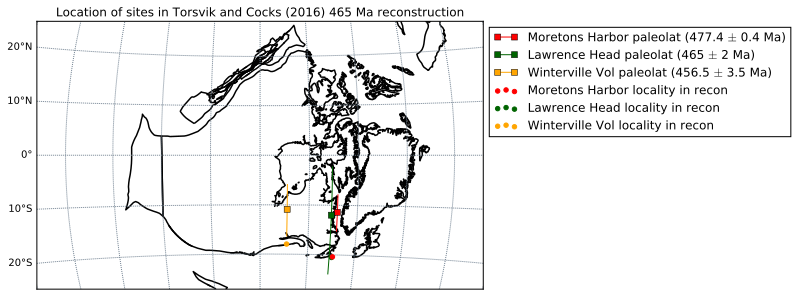

In [30]:
plt.figure(figsize=(8,8))

m = Basemap(width=10000000,height=6000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-160.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/TC2016_{0}Ma'.format(465),'Paleogeo', color='k', linewidth=1.5)

m.drawgreatcircle(Moreton_Harbour_locality_recon[1]+0.5, Notre_Dame_pmag.Paleolat_min.tolist()[0],
                  Moreton_Harbour_locality_recon[1]+0.5, Notre_Dame_pmag.Paleolat_max.tolist()[0], color='red')
m.plot(Moreton_Harbour_locality_recon[1]+0.5,Notre_Dame_pmag.Paleolat.tolist()[0],
       latlon=True,color='red',marker='s',label='Moretons Harbor paleolat (477.4 $\pm$ 0.4 Ma)')
m.scatter(Moreton_Harbour_locality_recon[1],Moreton_Harbour_locality_recon[0],
       latlon=True,color='red',marker='o',label='Moretons Harbor locality in recon',zorder=102)

m.drawgreatcircle(Lawrence_Head_locality_recon[1]-0.5, Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat_min.tolist()[0],
                  Lawrence_Head_locality_recon[1]-0.5, Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat_max.tolist()[0], color='darkgreen')
m.plot(Lawrence_Head_locality_recon[1]-0.5,Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='darkgreen',marker='s',label='Lawrence Head paleolat (465 $\pm$ 2 Ma)')
m.scatter(Lawrence_Head_locality_recon[1],Lawrence_Head_locality_recon[0],
       latlon=True,color='darkgreen',marker='o',label='Lawrence Head locality in recon',zorder=101)

m.drawgreatcircle(Winterville_locality_recon[1], Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat_min.tolist()[0],
                  Winterville_locality_recon[1], Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat_max.tolist()[0], color='orange')
m.plot(Winterville_locality_recon[1],Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='orange',marker='s',label='Winterville Vol paleolat (456.5 $\pm$ 3.5 Ma)')
m.scatter(Winterville_locality_recon[1],Winterville_locality_recon[0],
       latlon=True,color='orange',marker='o',label='Winterville Vol locality in recon',zorder=103)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left', ncol=1)
plt.title('Location of sites in Torsvik and Cocks (2016) 465 Ma reconstruction')
plt.show()

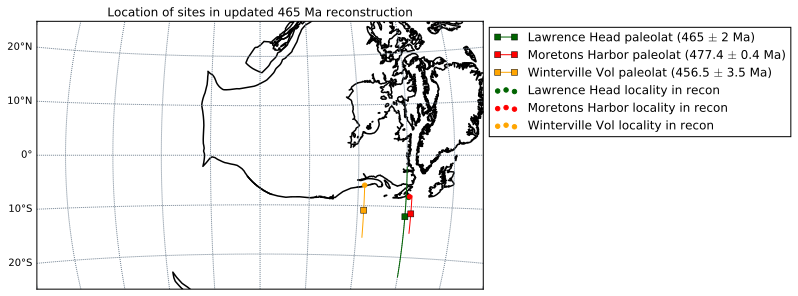

In [31]:
input_rotation_filename = '../Data/GPlates/TC2017_modified.rot'
anchor_plate = 1
reconstruction_time = 465
point_latitude = Notre_Dame_pmag.Slat.tolist()[0]
point_longitude = Notre_Dame_pmag.Slon.tolist()[0]
point_plate = 101

Moreton_Harbour_locality_recon_new = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)
reconstruction_time = 465
point_latitude = Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Slat.tolist()[0]
point_longitude = Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Slon.tolist()[0]
point_plate = 101

Lawrence_Head_locality_recon_new = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)

reconstruction_time = 465
point_latitude = Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Slat.tolist()[0]
point_longitude = Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Slon.tolist()[0]
point_plate = 101

Winterville_locality_recon_new = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)

plt.figure(figsize=(8,8))

m = Basemap(width=10000000,height=6000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-160.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/NewRecon_{0}Ma'.format(465),'Paleogeo', color='k', linewidth=1.5)

m.drawgreatcircle(Lawrence_Head_locality_recon_new[1]-0.5, Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat_min.tolist()[0],
                  Lawrence_Head_locality_recon_new[1]-0.5, Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat_max.tolist()[0], color='darkgreen')
m.plot(Lawrence_Head_locality_recon_new[1]-0.5,Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='darkgreen',marker='s',label='Lawrence Head paleolat (465 $\pm$ 2 Ma)')
m.scatter(Lawrence_Head_locality_recon_new[1],Lawrence_Head_locality_recon_new[0],
       latlon=True,color='darkgreen',marker='o',label='Lawrence Head locality in recon',zorder=101)

m.drawgreatcircle(Moreton_Harbour_locality_recon_new[1]+0.5, Notre_Dame_pmag.Paleolat_min.tolist()[0],
                  Moreton_Harbour_locality_recon_new[1]+0.5, Notre_Dame_pmag.Paleolat_max.tolist()[0], color='red')
m.plot(Moreton_Harbour_locality_recon_new[1]+0.5,Notre_Dame_pmag.Paleolat.tolist()[0],
       latlon=True,color='red',marker='s',label='Moretons Harbor paleolat (477.4 $\pm$ 0.4 Ma)')
m.scatter(Moreton_Harbour_locality_recon_new[1],Moreton_Harbour_locality_recon_new[0],
       latlon=True,color='red',marker='o',label='Moretons Harbor locality in recon',zorder=102)

m.drawgreatcircle(Winterville_locality_recon_new[1], Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat_min.tolist()[0],
                  Winterville_locality_recon_new[1], Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat_max.tolist()[0], color='orange')
m.plot(Winterville_locality_recon_new[1],Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='orange',marker='s',label='Winterville Vol paleolat (456.5 $\pm$ 3.5 Ma)')
m.scatter(Winterville_locality_recon_new[1],Winterville_locality_recon_new[0],
       latlon=True,color='orange',marker='o',label='Winterville Vol locality in recon',zorder=103)
plt.legend(bbox_to_anchor=(1, 1), loc='upper left', ncol=1)
plt.title('Location of sites in updated 465 Ma reconstruction')
plt.show()

In [32]:
plt.figure(figsize=(6,6))
#ax1 = fig.add_subplot(111)

m = Basemap(width=10000000,height=8500000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-145.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/TC2016_{0}Ma'.format(465),'Paleogeo', color='grey', linewidth=1.5)
# patches   = []
# for info, shape in zip(m.Paleogeo_info, m.Paleogeo):
#     patches.append( Polygon(np.array(shape), True) )
# ax1.add_collection(PatchCollection(patches, facecolor= 'slategrey', edgecolor='k', 
#                                    linewidths=1., zorder=2))

m.scatter(Moreton_Harbour_locality_recon[1],Moreton_Harbour_locality_recon[0],
          latlon=True,color='red',marker='o',s=40,
          label='Moretons Harbor locality in classic recon',zorder=102)

m.scatter(Lawrence_Head_locality_recon[1],Lawrence_Head_locality_recon[0],
          latlon=True,color='darkgreen',marker='o',s=40,
          label='Lawrence Head locality in classic recon',zorder=101)

m.scatter(Winterville_locality_recon[1],Winterville_locality_recon[0],
          latlon=True,color='orange',marker='o',s=40,
          label='Winterville Vol locality in classic recon',zorder=103)

m.readshapefile('../Data/GPlates/reconstructions/NewRecon_{0}Ma'.format(465),
                'Paleogeo', color='k', linewidth=1.5)

m.drawgreatcircle(Moreton_Harbour_locality_recon_new[1]+0.5, 
                  Notre_Dame_pmag.Paleolat_min.tolist()[0],
                  Moreton_Harbour_locality_recon_new[1]+0.5, 
                  Notre_Dame_pmag.Paleolat_max.tolist()[0], color='red')
m.plot(Moreton_Harbour_locality_recon_new[1]+0.5,Notre_Dame_pmag.Paleolat.tolist()[0],
       latlon=True,color='red',marker='s',
       label='Moretons Harbor paleolat (477.4 $\pm$ 0.4 Ma)')
m.scatter(Moreton_Harbour_locality_recon_new[1],Moreton_Harbour_locality_recon_new[0],
          latlon=True,color='red',marker='*',s=50,
          label='Moretons Harbor locality in new recon',zorder=102)

m.drawgreatcircle(Lawrence_Head_locality_recon_new[1]-0.5, 
                  Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat_min.tolist()[0],
                  Lawrence_Head_locality_recon_new[1]-0.5, 
                  Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat_max.tolist()[0], color='darkgreen')
m.plot(Lawrence_Head_locality_recon_new[1]-0.5,Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='darkgreen',marker='s',label='Lawrence Head paleolat (465 $\pm$ 2 Ma)')
m.scatter(Lawrence_Head_locality_recon_new[1],Lawrence_Head_locality_recon_new[0],
          latlon=True,color='darkgreen',marker='*',s=50,
          label='Lawrence Head locality in new recon',zorder=101)


m.drawgreatcircle(Winterville_locality_recon_new[1], 
                  Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat_min.tolist()[0],
                  Winterville_locality_recon_new[1], 
                  Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat_max.tolist()[0], color='orange')
m.plot(Winterville_locality_recon_new[1],Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='orange',marker='s',label='Winterville Vol paleolat (456.5 $\pm$ 3.5 Ma)')
m.scatter(Winterville_locality_recon_new[1],Winterville_locality_recon_new[0],
          latlon=True,color='orange',marker='*',s=50,
          label='Winterville Vol locality in new recon',zorder=103)

m.drawgreatcircle(Winterville_locality_recon_new[1]-2, 
                  Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Bluffer Pond Volcanics'].Paleolat_min.tolist()[0],
                  Winterville_locality_recon_new[1]-2, 
                  Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Bluffer Pond Volcanics'].Paleolat_max.tolist()[0], color='#FCED57')
m.plot(Winterville_locality_recon_new[1]-2,Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Bluffer Pond Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='#FCED57',marker='s')

m.drawgreatcircle(Winterville_locality_recon_new[1]-0.5, 
                  Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Stacyville Volcanics'].Paleolat_min.tolist()[0],
                  Winterville_locality_recon_new[1]-0.5, 
                  Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Stacyville Volcanics'].Paleolat_max.tolist()[0], color='#D4CF2B')
m.plot(Winterville_locality_recon_new[1]-0.5,Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Stacyville Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='#D4CF2B',marker='s')

m.drawgreatcircle(Lawrence_Head_locality_recon_new[1]-1, 
                  Victoria_pmag.ix[Victoria_pmag.Formation=='Summerford Volcanics'].Paleolat_min.tolist()[0],
                  Lawrence_Head_locality_recon_new[1]-1, 
                  Victoria_pmag.ix[Victoria_pmag.Formation=='Summerford Volcanics'].Paleolat_max.tolist()[0], color='pink')
m.plot(Lawrence_Head_locality_recon_new[1]-1,Victoria_pmag.ix[Victoria_pmag.Formation=='Summerford Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='pink',marker='s')

m.drawgreatcircle(Lawrence_Head_locality_recon_new[1]-3, 
                  Annieopsquotch_pmag.ix[Annieopsquotch_pmag.Formation=="Roberts Arm Volcanics"].Paleolat_min.tolist()[0],
                  Lawrence_Head_locality_recon_new[1]-3, 
                  Annieopsquotch_pmag.ix[Annieopsquotch_pmag.Formation=="Roberts Arm Volcanics"].Paleolat_max.tolist()[0], color='pink')
m.plot(Lawrence_Head_locality_recon_new[1]-3,Annieopsquotch_pmag.ix[Annieopsquotch_pmag.Formation=='Roberts Arm Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='pink',marker='s')

m.drawgreatcircle(Lawrence_Head_locality_recon_new[1]-5, 
                  Annieopsquotch_pmag.ix[Annieopsquotch_pmag.Formation=="Chanceport/Cortell's Cove Volcanics"].Paleolat_min.tolist()[0],
                  Lawrence_Head_locality_recon_new[1]-5, 
                  Annieopsquotch_pmag.ix[Annieopsquotch_pmag.Formation=="Chanceport/Cortell's Cove Volcanics"].Paleolat_max.tolist()[0], color='pink')
m.plot(Lawrence_Head_locality_recon_new[1]-5,Annieopsquotch_pmag.ix[Annieopsquotch_pmag.Formation=="Chanceport/Cortell's Cove Volcanics"].Paleolat.tolist()[0],
       latlon=True,color='pink',marker='s',
       label='other arc volcanics (469,469,)')

plt.legend(bbox_to_anchor=(1, 1), loc='upper left', ncol=1)

plt.savefig('./Output/paleogeo_comparative.pdf')
plt.show()

In [33]:
input_rotation_filename = '../Data/GPlates/TC2017.rot'
anchor_plate = 1
reconstruction_time = 475
point_latitude = Notre_Dame_pmag.Slat.tolist()[0]
point_longitude = Notre_Dame_pmag.Slon.tolist()[0]
point_plate = 101

Moreton_Harbour_locality_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)

reconstruction_time = 465
point_latitude = Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Slat.tolist()[0]
point_longitude = Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Slon.tolist()[0]
point_plate = 101

Lawrence_Head_locality_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)

reconstruction_time = 455
point_latitude = Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Slat.tolist()[0]
point_longitude = Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Slon.tolist()[0]
point_plate = 101

Winterville_locality_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)

input_rotation_filename = '../Data/GPlates/TC2017_modified.rot'
anchor_plate = 1
reconstruction_time = 475
point_latitude = Notre_Dame_pmag.Slat.tolist()[0]
point_longitude = Notre_Dame_pmag.Slon.tolist()[0]
point_plate = 101

Moreton_Harbour_locality_recon_new = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)
reconstruction_time = 465
point_latitude = Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Slat.tolist()[0]
point_longitude = Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Slon.tolist()[0]
point_plate = 101

Lawrence_Head_locality_recon_new = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)

reconstruction_time = 455
point_latitude = Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Slat.tolist()[0]
point_longitude = Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Slon.tolist()[0]
point_plate = 101

Winterville_locality_recon_new = reconstruct_point(input_rotation_filename,reconstruction_time,
                                                 anchor_plate,point_latitude,point_longitude,point_plate)

In [34]:
plt.figure(figsize=(14,14))
plt.subplot(4,2,1)
m = Basemap(width=12000000,height=8000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-150.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/TC2016_{0}Ma'.format(475),'Paleogeo', color='k', linewidth=1.5)
plt.title('475 Ma (classic reconstruction)')

m.drawgreatcircle(Moreton_Harbour_locality_recon[1]+0.5, Notre_Dame_pmag.Paleolat_min.tolist()[0],
                  Moreton_Harbour_locality_recon[1]+0.5, Notre_Dame_pmag.Paleolat_max.tolist()[0], color='red')
m.plot(Moreton_Harbour_locality_recon[1]+0.5,Notre_Dame_pmag.Paleolat.tolist()[0],
       latlon=True,color='red',marker='s',label='Moretons Harbor paleolat (477.4 $\pm$ 0.4 Ma)')
m.scatter(Moreton_Harbour_locality_recon[1],Moreton_Harbour_locality_recon[0],
       latlon=True,color='red',marker='o',label='Moretons Harbor locality in recon',zorder=102)

plt.legend()

plt.subplot(4,2,3)
m = Basemap(width=12000000,height=8000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-150.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/TC2016_{0}Ma'.format(465),'Paleogeo', color='k', linewidth=1.5)

m.drawgreatcircle(Lawrence_Head_locality_recon[1]-0.5, Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat_min.tolist()[0],
                  Lawrence_Head_locality_recon[1]-0.5, Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat_max.tolist()[0], color='darkgreen')
m.plot(Lawrence_Head_locality_recon[1]-0.5,Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='darkgreen',marker='s',label='Lawrence Head paleolat (465 $\pm$ 2 Ma)')
m.scatter(Lawrence_Head_locality_recon[1],Lawrence_Head_locality_recon[0],
       latlon=True,color='darkgreen',marker='o',label='Lawrence Head locality in recon',zorder=101)

plt.title('465 Ma  (classic reconstruction)')

plt.legend()

plt.subplot(4,2,5)
m = Basemap(width=12000000,height=8000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-150.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/TC2016_{0}Ma'.format(455),'Paleogeo', color='k', linewidth=1.5)

m.drawgreatcircle(Winterville_locality_recon[1], Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat_min.tolist()[0],
                  Winterville_locality_recon[1], Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat_max.tolist()[0], color='orange')
m.plot(Winterville_locality_recon[1],Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='orange',marker='s',label='Winterville Vol paleolat (456.5 $\pm$ 3.5 Ma)')
m.scatter(Winterville_locality_recon[1],Winterville_locality_recon[0],
       latlon=True,color='orange',marker='o',label='Winterville Vol locality in recon',zorder=103)

plt.title('455 Ma  (classic reconstruction)')

plt.legend()

plt.subplot(4,2,7)
m = Basemap(width=12000000,height=8000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-150.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/TC2016_{0}Ma'.format(445),'Paleogeo', color='k', linewidth=1.5)

plt.title('445 Ma  (classic reconstruction)')

plt.subplot(4,2,2)
m = Basemap(width=12000000,height=8000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-150.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/NewRecon_{0}Ma'.format(475),'Paleogeo', color='k', linewidth=1.5)
plt.title('475 Ma')

m.drawgreatcircle(Moreton_Harbour_locality_recon_new[1]+0.5, Notre_Dame_pmag.Paleolat_min.tolist()[0],
                  Moreton_Harbour_locality_recon_new[1]+0.5, Notre_Dame_pmag.Paleolat_max.tolist()[0], color='red')
m.plot(Moreton_Harbour_locality_recon_new[1]+0.5,Notre_Dame_pmag.Paleolat.tolist()[0],
       latlon=True,color='red',marker='s',label='Moretons Harbor paleolat (477.4 $\pm$ 0.4 Ma)')
m.scatter(Moreton_Harbour_locality_recon_new[1],Moreton_Harbour_locality_recon_new[0],
       latlon=True,color='red',marker='o',label='Moretons Harbor locality in recon',zorder=102)

plt.legend()

plt.subplot(4,2,4)
m = Basemap(width=12000000,height=8000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-150.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/NewRecon_{0}Ma'.format(465),'Paleogeo', color='k', linewidth=1.5)
plt.title('465 Ma')

m.drawgreatcircle(Lawrence_Head_locality_recon_new[1]-0.5, Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat_min.tolist()[0],
                  Lawrence_Head_locality_recon_new[1]-0.5, Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat_max.tolist()[0], color='darkgreen')
m.plot(Lawrence_Head_locality_recon_new[1]-0.5,Victoria_pmag.ix[Victoria_pmag.Formation=='Lawrence Head Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='darkgreen',marker='s',label='Lawrence Head paleolat (465 $\pm$ 2 Ma)')
m.scatter(Lawrence_Head_locality_recon_new[1],Lawrence_Head_locality_recon_new[0],
       latlon=True,color='darkgreen',marker='o',label='Lawrence Head locality in recon',zorder=101)

plt.legend()

plt.subplot(4,2,6)
m = Basemap(width=12000000,height=8000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-150.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/NewRecon_{0}Ma'.format(455),'Paleogeo', color='k', linewidth=1.5)
plt.title('455 Ma')

m.drawgreatcircle(Winterville_locality_recon_new[1], Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat_min.tolist()[0],
                  Winterville_locality_recon_new[1], Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat_max.tolist()[0], color='orange')
m.plot(Winterville_locality_recon_new[1],Bronson_Hill_pmag.ix[Bronson_Hill_pmag.Formation=='Winterville Volcanics'].Paleolat.tolist()[0],
       latlon=True,color='orange',marker='s',label='Winterville Vol paleolat (456.5 $\pm$ 3.5 Ma)')
m.scatter(Winterville_locality_recon_new[1],Winterville_locality_recon_new[0],
       latlon=True,color='orange',marker='o',label='Winterville Vol locality in recon',zorder=103)

plt.legend()

plt.subplot(4,2,8)
m = Basemap(width=12000000,height=8000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-150.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/NewRecon_{0}Ma'.format(445),'Paleogeo', color='k', linewidth=1.5)
plt.title('445 Ma')

plt.tight_layout()
plt.savefig('./Output/paleogeo_subplots.pdf')
plt.show()

## Data from Britain north of Iapetus suture

Paleomagnetic data from the Loch Borralan Pluton used to be considered Ordovician in age (Turnell and Briden, 1983), but U-Pb age constraints now show the early suite of the pluton to be 431.1 $\pm$ 1.2 Ma and  429.2 $\pm$ 0.5 Ma thereby firmly constraining it to be Silurian (Goodenough et al., 2011). The Loch Ailsh Pluton has been dated at 430.6 $\pm$ 0.3 Ma rendering that paleomagnetic data to be Silurian as well (Goodenough et al., 2011). A concordant zircon from the Loch Loyal Syenite Complex at ca. 425 Ma (Goodenough et al., 2011) points towards the Ben Loyal paleomagnetic data of \cite{Turnell1983a} also being Silurian. Data from these Silurian plutons are consistent with the paleolatitude of the Scottish Highlands in both the classic and revised model which converge by 430 Ma. The convergence of the classic and new paleogeographic models as well as the paleolatitudes of the paleomagnetic constraints and the reconstructed positions of two of the mean paleomagnetic directions are shown below.

In [35]:
#Loch Ailsh (Turnell and Briden, 1983)
input_rotation_filename = '../Data/GPlates/TC2017.rot'
anchor_plate = 1
reconstruction_time = 430
point_latitude = 58.1
point_longitude = -4.8
point_plate = 303

Loch_Ailsh_locality_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                              anchor_plate,point_latitude,point_longitude,point_plate)

# Borrolan Syenite (Turnell and Briden, 1983)
point_latitude = 58.0
point_longitude = -4.9
Borrolan_locality_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                              anchor_plate,point_latitude,point_longitude,point_plate)

In [36]:
plt.figure(figsize=(14,14))
plt.subplot(1,2,1)
m = Basemap(width=12000000,height=8000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-150.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/TC2016_{0}Ma'.format(430),'Paleogeo', color='k', linewidth=1.5)

#Loch Ailsh (D=33.1, I=-21.6, a95=4.6)
# In [11]: ipmag.lat_from_inc(-21.6)
# Out[11]: -11.19772141810461

# In [12]: ipmag.lat_from_inc(-21.6+4.6)
# Out[12]: -8.6912570738831647

# In [13]: ipmag.lat_from_inc(-21.6-4.6)
# Out[13]: -13.821987382961305

m.drawgreatcircle(Loch_Ailsh_locality_recon[1]-0.2, -8.7,
                  Loch_Ailsh_locality_recon[1]-0.2, -13.8, color='orange',label='Loch Ailsh paleolat range')
m.scatter(Loch_Ailsh_locality_recon[1]-0.2,Loch_Ailsh_locality_recon[0],
       latlon=True,color='orange',marker='o',label='Loch Ailsh locality in recon',zorder=103)

# Borrolan Syenite (D=26.9, I=-19.4, a95=7.5)
# In [2]: ipmag.lat_from_inc(-19.4)
# Out[2]: -9.9861526417677293

# In [3]: ipmag.lat_from_inc(-19.4-7.5)
# Out[3]: -14.23368102553421

# In [4]: ipmag.lat_from_inc(-19.4+7.5)
# Out[4]: -6.0148635619996069

m.drawgreatcircle(Borrolan_locality_recon[1]+0.2, -6,
                  Borrolan_locality_recon[1]+0.2, -14.2, color='red',label='Borrolan Syenite paleolat range')
m.scatter(Borrolan_locality_recon[1]+0.2,Borrolan_locality_recon[0],
       latlon=True,color='red',marker='o',label='Borrolan Syenite locality in recon',zorder=103)

plt.subplot(1,2,2)
m = Basemap(width=12000000,height=8000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-150.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/NewRecon_{0}Ma'.format(430),'Paleogeo', color='k', linewidth=1.5)
plt.title('435 Ma')

m.drawgreatcircle(Loch_Ailsh_locality_recon[1]-0.2, -8.7,
                  Loch_Ailsh_locality_recon[1]-0.2, -13.8, color='orange',label='Loch Ailsh paleolat range')
m.scatter(Loch_Ailsh_locality_recon[1]-0.2,Loch_Ailsh_locality_recon[0],
       latlon=True,color='orange',marker='o',label='Loch Ailsh locality in recon',zorder=103)

m.drawgreatcircle(Borrolan_locality_recon[1]+0.2, -6,
                  Borrolan_locality_recon[1]+0.2, -14.2, color='red',label='Borrolan Syenite paleolat range')
m.scatter(Borrolan_locality_recon[1]+0.2,Borrolan_locality_recon[0],
       latlon=True,color='red',marker='o',label='Borrolan Syenite locality in recon',zorder=103)

plt.legend()
plt.show()

## Implication of new reconstruction for climatically relevant deposits

Jin et al. (2013) argued that the massive-bedded Thalassinoides ichnofacies and nonamalgamated shell beds could not have been preserved in environments that experience hurricane-grade storms and were therefore deposited within 10° of the equator. The presence of these facies in Late Ordovician Laurentia carbonates was used to infer the position of the equator. As shown in the compilation of Jin et al. (2013), the absence or presence of storm tracks is complicated and therefore a subtropical position does not inherently mean that sediments would be influenced by hurricane-grade stroms.  Our modified reconstruction of Laurentia reconstructs carbonates with these facies northwards of the reconstruction of Jin et al. (2013) as that reconstruction had a "classic" position of the Applachian margin in the subtropics. However, our reconstruction at 445 Ma largly honors these proposed constraints with all points within 12º of the equator and the majority closer.

These points from the Jin et al., 2013 data repository are restored according to the modified reconstruction below. From the Jin et al. 2013 Data repository materia:

> Massive-bedded Thalassinoides facies (MBTF; see Table DR1)
1. Gillis Quarry, Garson, southern Manitoba, 50°04’30”N, 96°41’45”W.
2. Hunt Mountain, Bighorn Mountains, Wyoming (Holland and Patzkowsky, 2007), 44°44’19.4”N, 107°43’41.3”W.
3. Børglum Elv, Peary Land, North Greenland, 82°28’29.7”N, 30°45’22.8”W.
4. Great Basin, Nevada and Utah, southwestern USA (Sheehan and Schiefelbein, 1984). A, Barn Hills, Utah. 38°58’36”N, 113°23’25”W. B, Tony Grove Lake, Utah, 41°53’30.5”N, 111°38’51.8”W. C, Tony Grove Lake, Utah, 41°53’30.5”N, 111°38’51.8”W. D, Toano Range, Nevada, 41°2’5”N, 114°15’12”W. E, Ricks Canyon, Newfoundland Range, Utah, 41°8’37”N, 113°22’39”W. F, Lakeside Mountains, Utah, 40°52’25”N, 112°45’28”W.

> Non-amalgamated brachiopod shell beds (NABS; see Table DR1)
1. G.B. Schley Fjord, Peary Land, North Greenland, 82°54’56.8”N, 25°44’56.7”W. 
2. northeastern Brodeur Peninsula, Baffin Island, 73°33’02”N, 85°22’00”W.

In [37]:
import re

def dms2dd(degrees, minutes, seconds, direction):
    dd = float(degrees) + float(minutes)/60 + float(seconds)/(60*60);
    if direction == 'S' or direction == 'W':
        dd *= -1
    return dd

MBTF_1_lat = dms2dd(50,4,30,'N')
MBTF_1_lon = dms2dd(96,41,45,'W')

MBTF_2_lat = dms2dd(44,44,19.4,'N')
MBTF_2_lon = dms2dd(107,43,41.3,'W')

MBTF_3_lat = dms2dd(82,28,29.7,'N')
MBTF_3_lon = dms2dd(30,45,22.8,'W')

MBTF_4_lat = dms2dd(38,58,36,'N')
MBTF_4_lon = dms2dd(113,23,25,'W')

NABS_1_lat = dms2dd(82,54,57,'N')
NABS_1_lon = dms2dd(25,44,57,'W')

NABS_2_lat = dms2dd(73,33,2,'N')
NABS_2_lon = dms2dd(85,22,36,'W')

reconstruction_time = 445
anchor_plate = 1
input_rotation_filename = '../Data/GPlates/TC2017_modified.rot'

MBTF_1_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                 anchor_plate,MBTF_1_lat,MBTF_1_lon,
                                 point_plate=101)

MBTF_2_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                 anchor_plate,MBTF_2_lat,MBTF_2_lon,
                                 point_plate=101)

MBTF_3_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                 anchor_plate,MBTF_3_lat,MBTF_3_lon,
                                 point_plate=102)

MBTF_4_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                 anchor_plate,MBTF_4_lat,MBTF_4_lon,
                                 point_plate=101)

NBS_1_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                 anchor_plate,NABS_1_lat,NABS_1_lon,
                                 point_plate=102)

NBS_2_recon = reconstruct_point(input_rotation_filename,reconstruction_time,
                                 anchor_plate,NABS_2_lat,NABS_2_lon,
                                 point_plate=102)

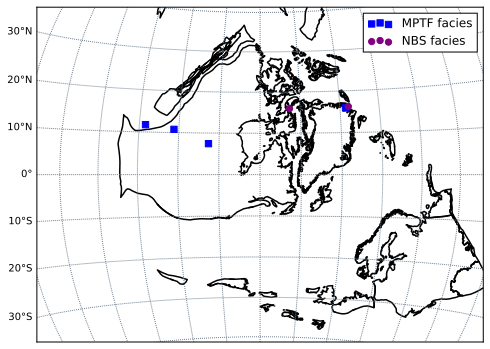

In [38]:
plt.figure(figsize=(8,8))

m = Basemap(width=12000000,height=9000000,
            resolution='l',projection='laea',\
            lat_ts=0,lat_0=0,lon_0=-140.)
m.drawmapboundary(fill_color='white')
m.drawmeridians(np.arange(0,360,10),color='slategrey')
m.drawparallels(np.arange(-90,90,10),labels=[1, 0, 0, 0],color='slategrey')
m.readshapefile('../Data/GPlates/reconstructions/NewRecon_{0}Ma'.format(445),
                'Paleogeo', color='k', linewidth=1.5)

m.scatter(MBTF_1_recon[1],MBTF_1_recon[0],
          latlon=True,color='blue',marker='s',s=40,
          label='MPTF facies',zorder=102)

m.scatter(MBTF_2_recon[1],MBTF_2_recon[0],
          latlon=True,color='blue',marker='s',s=40,
          zorder=102)

m.scatter(MBTF_3_recon[1],MBTF_3_recon[0],
          latlon=True,color='blue',marker='s',s=40,
          zorder=102)

m.scatter(MBTF_4_recon[1],MBTF_4_recon[0],
          latlon=True,color='blue',marker='s',s=40,
          zorder=102)

m.scatter(NBS_1_recon[1],NBS_1_recon[0],
          latlon=True,color='purple',marker='o',s=40,
          label='NBS facies',zorder=102)

m.scatter(NBS_2_recon[1],NBS_2_recon[0],
          latlon=True,color='purple',marker='o',s=40,
          zorder=102)

plt.legend()
plt.show()

### Plot chemostratigraphic data along with paleolatitudinal constraints and model (Figure 1 of manuscript)

In [39]:
input_rotation_filename = '../Data/GPlates/TC2017_modified.rot'
anchor_plate = 1
lat_NY = 40.7
lon_NY = -74
point_plate = 101

new_model_NY_lat = []
new_model_NY_lon = []
age = []
for time in np.arange(400,501,1):
    position = reconstruct_point(input_rotation_filename,time,
                                 anchor_plate,lat_NY,lon_NY,point_plate)
    new_model_NY_lat.append(position[0])
    new_model_NY_lon.append(position[1])
    age.append(-time)
    
input_rotation_filename = '../Data/GPlates/TC2017.rot'    

old_model_NY_lat = []
old_model_NY_lon = []
age = []
for time in np.arange(400,501,1):
    position = reconstruct_point(input_rotation_filename,time,
                                 anchor_plate,lat_NY,lon_NY,point_plate)
    old_model_NY_lat.append(position[0])
    old_model_NY_lon.append(position[1])
    age.append(-time)

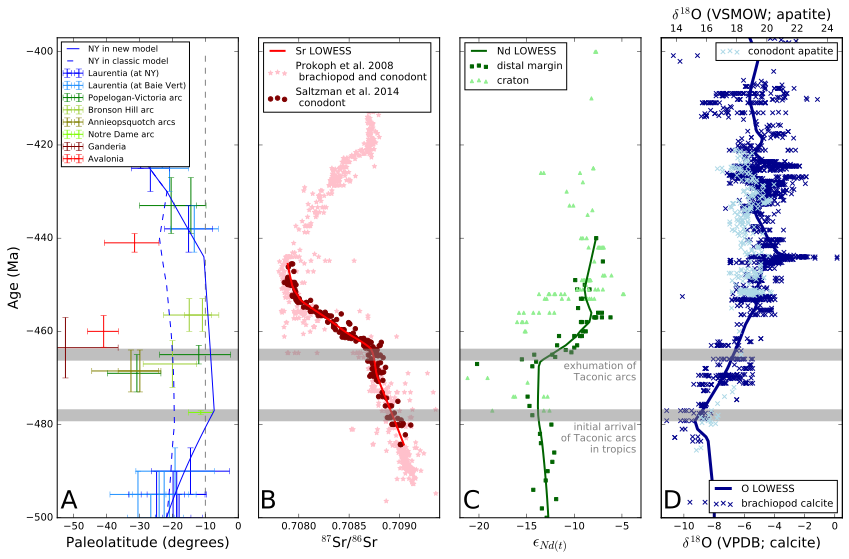

In [40]:
plt.figure(figsize=(12,8))

ax1 = plt.subplot(1,4,1)
plot_paleolat()
plt.plot(new_model_NY_lat,age,color='blue',label='NY in new model')
plt.plot(old_model_NY_lat,age,linestyle='dashed',color='blue',label='NY in classic model')
plt.xlabel('Paleolatitude (degrees)', fontsize=14)
plt.ylabel('Age (Ma)', fontsize=14)
plt.ylim(-500,-397)
plt.xlim(-55,0)
plt.vlines(-10,-500,-400,color='grey',linestyle='--')
plt.legend(loc=2,fontsize='small')
plt.text(-54, -498, 'A', fontsize=25)
ax1.axhline(-465,color='grey',linewidth=12,alpha=0.5,zorder=-1)
ax1.axhline(-478,color='grey',linewidth=12,alpha=0.5,zorder=-1)

ax2 = plt.subplot(1,4,2)
plt.scatter(Sr_composite_Prokoph['87Sr/86Sr'],-Sr_composite_Prokoph['Age (Ma)'],
            color='pink',marker='*',label='Prokoph et al. 2008\n brachiopod and conodont')
plt.scatter(Sr_composite_Saltzman['87_86'],-Sr_composite_Saltzman.Age,
            color='maroon',label='Saltzman et al. 2014\n conodont')
plt.plot(lowess_Sr_3[:, 1],-lowess_Sr_3[:, 0],'r',label='Sr LOWESS',lw=2)
plt.xlim(.7076,.7094)
plt.ylim(-500,-397) 
plt.xlabel('$^{87}$Sr/$^{86}$Sr', fontsize=14)
plt.legend(loc=2,fontsize='medium')
ax2.set_yticklabels([])
plt.text(.70761, -498, 'B', fontsize=25)
ax2.axhline(-465,color='grey',linewidth=12,alpha=0.5)
ax2.axhline(-478,color='grey',linewidth=12,alpha=0.5)

ax3 = plt.subplot(1,4,3)
plt.scatter(Nd_composite_distal['Epsilon Nd (t)'],-Nd_composite_distal['Age (Ma)'],
            color='darkgreen',marker='s',s=10,label='distal margin')
plt.scatter(Nd_composite_foreland['Epsilon Nd (t)'],-Nd_composite_foreland['Age (Ma)'],
            color='lightgreen',marker='^',s=10,label='craton')
plt.plot(lowess_Nd_4[:, 1],-lowess_Nd_4[:, 0],'darkgreen',lw=2,label='Nd LOWESS')
plt.xlim(-22,-3)
plt.ylim(-500,-397)
plt.xlabel('$\epsilon_{Nd(t)}$', fontsize=16)
plt.legend(loc=2,fontsize='medium')
ax3.set_yticklabels([])
plt.text(-21.7, -498, 'C', fontsize=25)
ax3.axhline(-465,color='grey',linewidth=12,alpha=0.5)
ax3.text(-3.5,-470.5,'exhumation of\n Taconic arcs',horizontalalignment='right',color='grey')
ax3.axhline(-478,color='grey',linewidth=12,alpha=0.5)
ax3.text(-3.5,-486,'initial arrival\n of Taconic arcs\n in tropics',horizontalalignment='right',color='grey')

ax4 = plt.subplot(1,4,4)
plt.scatter(O_composite_Viezer.d18O,-O_composite_Viezer.gts2012,
            color='darkblue',marker='x',label='brachiopod calcite')
plt.plot(lowess_O_05[:,1],-lowess_O_05[:,0],color='darkblue',lw=3,label='O LOWESS')
plt.xlim(-11.5,0.5)
plt.ylim(-500,-397)
plt.xlabel('$\delta^{18}$O (VPDB; calcite)', fontsize=14)
plt.legend(loc='lower right',fontsize='medium')
ax5 = ax4.twiny()
ax5.scatter(O_composite_conodont['d18O_phos'],-O_composite_conodont['Age (Ma)'],
            color='lightblue',marker='x',label='conodont apatite')
plt.xlim(13,25)
plt.ylim(-500,-397)
plt.xlabel('$\delta^{18}$O (VSMOW; apatite)', fontsize=14)
plt.legend(loc='upper right',fontsize='medium')
plt.text(13.1, -498, 'D', fontsize=25)
ax4.axhline(-465,color='grey',linewidth=12,alpha=0.5)
ax4.axhline(-478,color='grey',linewidth=12,alpha=0.5)
ax4.set_yticklabels([])

plt.tight_layout()
plt.savefig('./Output/composite_paleolat_chemostrat.pdf')
plt.show()